# Please note we have given training code and analysis code for all techniques done as part of ML component of our project. We had uploaded the data to a database for querying in the website. To run below cells, make sure you have the files in place to read data from

# Please make sur eyou have downloaded the main_transactions_data.parquet file mentioned in README.md file. Its a big file, and hence its not kept in github repo

In [1]:
# cohort analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
import seaborn as sns

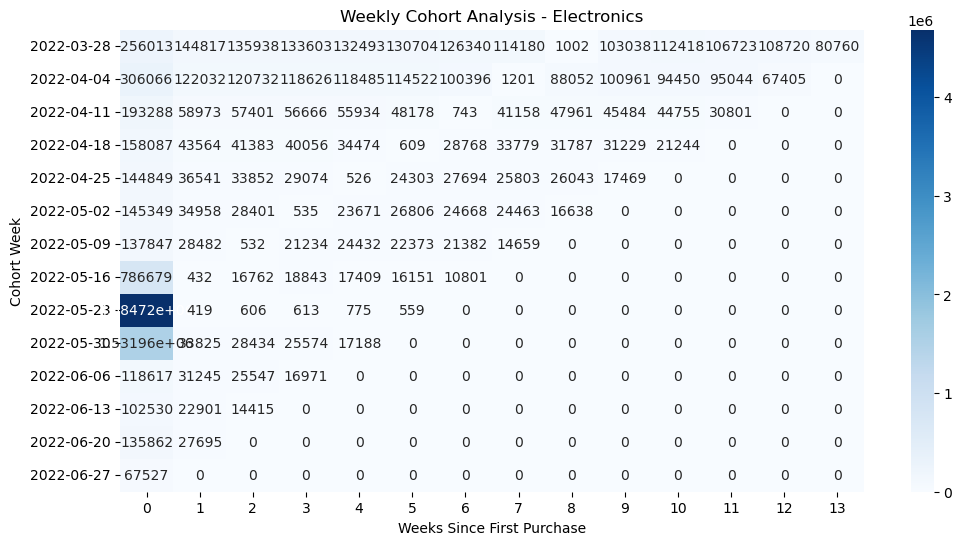

In [2]:
df=pd.read_csv('cohort_analysis_data.csv')
subset = df[df['l0_category'] == 'All'].pivot_table(
    index='cohort_week', columns='cohort_index', values='customer_count', fill_value=0
)

plt.figure(figsize=(12, 6))
sns.heatmap(subset, annot=True, fmt='g', cmap='Blues')
plt.title('Weekly Cohort Analysis - Electronics')
plt.xlabel('Weeks Since First Purchase')
plt.ylabel('Cohort Week')
plt.show()


# Market Basket Analysis and  Product Recommendation System

In [3]:
import pandas as pd
import numpy as np

product=pd.read_csv('products.csv')

In [4]:
del product['Unnamed: 0']

In [5]:
sales=pd.read_parquet('main_data_transactions.parquet')

In [6]:
sales=sales[['date_','order_id','product_id','dim_customer_key','total_weighted_landing_price']]

In [7]:
for x in product['l0_category'].unique():
    print(product[product.l0_category==x]['product_type'].unique())

['Card' 'Sample' 'Print as a Service' 'Free Gift' 'Chair Pad'
 'Silver Coin']
['Chocolate Bar' 'Digestive Tablets' 'Dark Chocolate' 'Wafer Bar'
 'Chocolate' 'Gulkand' 'Dark Chocolate Bar' 'Chocolate Pack'
 'Chocolate Gift Pack' 'Chewing Gum' 'Lollipop' 'Chocolate Share Bags'
 'Mouth Freshener' 'Toffee Pack' 'Milk Chocolate' 'Wafer Chocolate'
 'Jelly' 'Gift Pack' 'Gum' 'Filled Bar' 'Candy' 'Shaped Chocolates'
 'Chocolate Bag' 'Flavoured Yogurt' 'Lozenges' 'Biscuit' 'Bubble Gum'
 'Chocolate Gift Box' 'Chocolate Truffles' 'Gift Hamper' 'Marshmallow'
 'Marzipan' 'Snack' 'Combo' 'Filled Bars' 'Choco Chips'
 'White Chocolate Bar' 'Wafer Roll' 'Wafer' 'Chocolate Box'
 'White Chocolate' 'Chocolate Sticks' 'Pack' 'Toffee' 'Cardamom Whole'
 'Amla' 'Chocolate Bars' 'Sticks' 'Papad' 'Gift Box' 'Hot Chocolate'
 'Chikki' 'Ras Malai' 'Pak' 'Modak' 'Sweet' 'Soan Papdi' 'Bite' 'Burfi'
 'Sweets' 'Rewri' 'Gulab Jamun' 'Katli' 'Laddu' 'Rasgulla' 'Halwa' 'Gajak'
 'Dates' 'Peda' 'Gujiya' 'Milk Cake' 'Cham c

In [8]:
product2=product[['product_id','product_type','l0_category']]

In [9]:
main_copy=pd.merge(sales,product2,on='product_id')

In [10]:
del sales

In [38]:
data[(data.date_>='2022-05-22')&(data.date_<='2022-06-01')]

,date_,order_id,product_id,dim_customer_key,total_weighted_landing_price,product_type
8919,2022-06-01,127148575,344107,15315228,210.41673,Atta
8922,2022-06-01,127039523,344107,7382308,210.37344,Atta
8923,2022-06-01,127053290,344107,17856113,210.39203,Atta
8926,2022-06-01,127082948,344107,18317674,210.41661,Atta
8930,2022-06-01,127151791,344107,3608919,220.29099,Atta
...,...,...,...,...,...,...
46162172,2022-06-01,127151536,476056,17662706,1274.24600,Gift Pack
46162213,2022-06-01,127055675,479324,4441751,419.30600,Mayonnaise
46162241,2022-06-01,127139333,445082,4219,1394.85440,Body Butter
46162345,2022-06-01,127257842,437375,3082015,175.91573,Health Drink


In [43]:
from mlxtend.frequent_patterns import apriori, association_rules
from mlxtend.preprocessing import TransactionEncoder
import pandas as pd
from itertools import combinations
from collections import defaultdict
import numpy as np
import pickle
from mlxtend.frequent_patterns import fpgrowth
from collections import defaultdict
import json
# main_copy=data.copy()
for l0_cat in main_copy['l0_category'].unique():
    data=main_copy[main_copy['l0_category']==l0_cat].reset_index(drop=True)
    print(l0_cat)
    basket = data.groupby(['order_id'])['product_type'].apply(list)
    te = TransactionEncoder()
    te_ary = te.fit(basket).transform(basket)
    df_encoded = pd.DataFrame(te_ary, columns=te.columns_)
    print('df encoded ready')
    frequent_itemsets = apriori(df_encoded, min_support=0.01, use_colnames=True,verbose=10,low_memory=True)
    frequent_itemsets['support_count'] = (frequent_itemsets['support'] * len(df_encoded)).astype(int)
    display(frequent_itemsets)
    print('apriori done')
    
    rules = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.1)
    print('asso done')
    rules['antecedents'] = rules['antecedents'].apply(lambda x: list(x)[0] if len(x)==1 else ', '.join(x))
    rules['consequents'] = rules['consequents'].apply(lambda x: list(x)[0] if len(x)==1 else ', '.join(x))
    display(rules)
    pair_counts = defaultdict(int)
    for items in basket:
        for pair in combinations(sorted(set(items)), 2):
            pair_counts[pair] += 1
    
    # get all uniq itesm
    unique_items = sorted(set(item for transaction in basket for item in transaction))
    item_index = {item: idx for idx, item in enumerate(unique_items)}
    
    heatmap_matrix = np.zeros((len(unique_items), len(unique_items)), dtype=int)
    for (item1, item2), count in pair_counts.items():
        i, j = item_index[item1], item_index[item2]
        heatmap_matrix[i, j] = count
        heatmap_matrix[j, i] = count  # symmetric
    
    heatmap_df = pd.DataFrame(heatmap_matrix, index=unique_items, columns=unique_items)
    print('heatmap')
    display(heatmap_df)
# sankey data made here for final visaul
    sankey_nodes = [{'name': item} for item in unique_items]
    sankey_links = []
    for _, row in rules.iterrows():
        if row['antecedents'] in item_index and row['consequents'] in item_index:
            sankey_links.append({
                'source': item_index[row['antecedents']],
                'target': item_index[row['consequents']],
                'value': int(row['support'] * len(df_encoded))
            })
    
    frequent_itemsets_output = frequent_itemsets[['itemsets', 'support', 'support_count']]
    association_rules_output = rules[['antecedents', 'consequents', 'support', 'confidence', 'lift']]
    heatmap_output = heatmap_df
    sankey_output = {'nodes': sankey_nodes, 'links': sankey_links}


    #saving
    frequent_itemsets_output.to_csv(f'mba/frequent_itemsets_output_{l0_cat}.csv',index=False)
    association_rules_output.to_csv(f'mba/association_rules_output_{l0_cat}.csv',index=False)
    heatmap_output.to_csv(f'mba/heatmap_output_{l0_cat}.csv',index=False)
    with open(f'mba/sankey_output_{l0_cat}.pkl', 'wb') as handle:
        pickle.dump(sankey_output, handle, protocol=pickle.HIGHEST_PROTOCOL)  

    # break

    # fp tree code
    frequent_itemsets_fp = fpgrowth(df_encoded, min_support=0.01, use_colnames=True)
    frequent_itemsets_fp['length'] = frequent_itemsets_fp['itemsets'].apply(lambda x: len(x))
    frequent_itemsets_fp = frequent_itemsets_fp.sort_values(['length', 'support'], ascending=[False, False])
    def insert_itemset(tree, items, support):
        if not items:
            return
        item = items[0]
        existing = next((child for child in tree['children'] if child['name'].startswith(item)), None)
        if existing:
            existing_count = int(existing['name'].split(":")[1]) + support
            existing['name'] = f"{item}:{existing_count}"
            insert_itemset(existing, items[1:], support)
        else:
            new_node = {"name": f"{item}:{support}", "children": []}
            tree['children'].append(new_node)
            insert_itemset(new_node, items[1:], support)

    tree = {"name": "null", "children": []}
    print('len of frequent_itemsets',len(frequent_itemsets_fp))
    print('start loop')
    for indx, row in frequent_itemsets_fp.iterrows():
        #print(indx,end='\r')
        items = list(row['itemsets'])
        support = int(row['support'] * len(basket))
        if len(items) > 1:
            sorted_items = sorted(items)  # optional: apply order based on frequency
            insert_itemset(tree, sorted_items, support)
    with open(f'mba/fp_output_{l0_cat}.pkl', 'wb') as handle:
        pickle.dump(tree, handle, protocol=pickle.HIGHEST_PROTOCOL)  
    
#frequent_itemsets_output.head(), association_rules_output.head(), heatmap_output.head(), sankey_output['nodes'][:5], sankey_output['links'][:5]

Atta, Rice & Dal
df encoded ready
Processing 132 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.136308,(Arhar Dal),260262
1,0.247980,(Atta),473485
2,0.122117,(Basmati Rice),233166
3,0.116568,(Besan),222571
4,0.022153,(Black Masoor Dal),42298
...,...,...,...
70,0.010574,"(Sooji, Kala Chana)",20189
71,0.012951,"(Sooji, Maida)",24729
72,0.010888,"(Masoor Dal, Moong Dal (Dhuli))",20789
73,0.012345,"(Sooji, Moong Dal (Dhuli))",23571


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Arhar Dal,Atta,0.136308,0.247980,0.028560,0.209523,0.844920,1.0,-0.005242,0.951350,-0.175266,0.080285,-0.051138,0.162346
1,Atta,Arhar Dal,0.247980,0.136308,0.028560,0.115169,0.844920,1.0,-0.005242,0.976110,-0.196186,0.080285,-0.024475,0.162346
2,Basmati Rice,Arhar Dal,0.122117,0.136308,0.014826,0.121411,0.890712,1.0,-0.001819,0.983045,-0.122626,0.060864,-0.017248,0.115091
3,Arhar Dal,Basmati Rice,0.136308,0.122117,0.014826,0.108771,0.890712,1.0,-0.001819,0.985025,-0.124390,0.060864,-0.015202,0.115091
4,Arhar Dal,Besan,0.136308,0.116568,0.020406,0.149703,1.284254,1.0,0.004517,1.038969,0.256269,0.087778,0.037507,0.162379
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67,Moong Dal (Dhuli),Masoor Dal,0.075552,0.032781,0.010888,0.144111,4.396163,1.0,0.008411,1.130075,0.835665,0.111733,0.115103,0.238126
68,Sooji,Moong Dal (Dhuli),0.120563,0.075552,0.012345,0.102394,1.355278,1.0,0.003236,1.029904,0.298082,0.067176,0.029036,0.132895
69,Moong Dal (Dhuli),Sooji,0.075552,0.120563,0.012345,0.163396,1.355278,1.0,0.003236,1.051199,0.283568,0.067176,0.048705,0.132895
70,Sooji,Thick Poha,0.120563,0.094281,0.021935,0.181939,1.929762,1.0,0.010568,1.107154,0.547852,0.113707,0.096783,0.207298


heatmap


,Ambemohar Rice,Arhar Dal,Atta,Bajra,Bajra Flour,Barley,Barley Flour,Barnyard Millet,Basmati Rice,Besan,...,Sushi Rice,Thick Poha,Thin Poha,Tibar Basmati Rice,Urad (Sabut),Urad Dal (Chilka),Urad Dal (Dhuli),Urad Gota,White Dried Peas,White Lobiya
Ambemohar Rice,0,253,85,2,9,0,0,0,112,89,...,0,83,14,7,8,4,52,4,18,15
Arhar Dal,253,0,54531,41,217,123,0,63,28309,38962,...,0,28812,2952,234,7156,9897,17065,3293,4996,3558
Atta,85,54531,0,48,320,79,0,29,39645,40102,...,0,28616,2358,198,4705,5513,8047,1139,3551,2070
Bajra,2,41,48,0,15,4,0,0,34,50,...,0,45,5,1,8,12,13,0,3,6
Bajra Flour,9,217,320,15,0,1,0,0,120,245,...,0,147,9,1,31,31,55,3,27,27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Urad Dal (Chilka),4,9897,5513,12,31,13,0,2,2948,6173,...,0,3281,153,27,2841,0,2783,114,650,933
Urad Dal (Dhuli),52,17065,8047,13,55,57,0,30,4058,8158,...,0,6322,1061,44,2503,2783,0,465,1429,1057
Urad Gota,4,3293,1139,0,3,34,0,19,425,737,...,0,936,351,2,75,114,465,0,152,88
White Dried Peas,18,4996,3551,3,27,2,0,1,1787,3557,...,0,2620,279,18,662,650,1429,152,0,794


len of frequent_itemsets 75
start loop
Dry Fruits, Masala & Oil
df encoded ready
Processing 4 combinations | Sampling itemset size 32


,support,itemsets,support_count
0,0.015062,(Ajwain Seeds),34706
1,0.040677,(Almonds),93727
2,0.017400,(Amchur Powder),40092
3,0.012190,(Black Salt),28087
4,0.041736,(Cashews),96168
...,...,...,...
69,0.018550,"(Sulphurless Sugar, Salt)",42743
70,0.017069,"(Turmeric Powder, Salt)",39330
71,0.010993,"(Sulphurless Sugar, Soyabean Oil)",25331
72,0.010112,"(Sulphurless Sugar, Turmeric Powder)",23300


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Almonds,Cashews,0.040677,0.041736,0.014501,0.356482,8.541300,1.0,0.012803,1.489102,0.920359,0.213518,0.328454,0.351958
1,Cashews,Almonds,0.041736,0.040677,0.014501,0.347434,8.541300,1.0,0.012803,1.470077,0.921377,0.213518,0.319764,0.351958
2,Raisins,Cashews,0.028960,0.041736,0.011012,0.380239,9.110525,1.0,0.009803,1.546184,0.916787,0.184499,0.353246,0.322040
3,Cashews,Raisins,0.041736,0.028960,0.011012,0.263840,9.110525,1.0,0.009803,1.319062,0.929010,0.184499,0.241885,0.322040
4,Coriander Powder,Chilli Powder,0.057462,0.088983,0.022348,0.388926,4.370814,1.0,0.017235,1.490847,0.818227,0.180090,0.329240,0.320041
5,Chilli Powder,Coriander Powder,0.088983,0.057462,0.022348,0.251156,4.370814,1.0,0.017235,1.258657,0.846537,0.180090,0.205502,0.320041
6,Cumin Seeds / Jeera Seeds,Chilli Powder,0.081902,0.088983,0.018476,0.225591,2.535222,1.0,0.011189,1.176403,0.659578,0.121229,0.149951,0.216616
7,Chilli Powder,Cumin Seeds / Jeera Seeds,0.088983,0.081902,0.018476,0.207641,2.535222,1.0,0.011189,1.158689,0.664704,0.121229,0.136955,0.216616
8,Mustard Oil,Chilli Powder,0.165044,0.088983,0.019504,0.118173,1.328043,1.0,0.004818,1.033102,0.295839,0.083163,0.032041,0.168679
9,Chilli Powder,Mustard Oil,0.088983,0.165044,0.019504,0.219185,1.328043,1.0,0.004818,1.069340,0.271139,0.083163,0.064843,0.168679


heatmap


,Ajwain Seeds,Almond,Almonds,Amchur Powder,Anardana,Anjeer,Apricots,Assorted Dried Fruits,Avocado Oil,Basil Leaves,...,Tamarind Powder,Tikka Masala,Turmeric Powder,Turmeric Whole,Vanaspati,Vegetable Oil,Walnut Kernels,Walnuts,Watermelon Seeds,White Sesame Seeds
Ajwain Seeds,0,0,1679,2250,165,199,2,14,0,4,...,0,0,5668,68,92,9,481,87,220,450
Almond,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Almonds,1679,0,0,1391,61,3575,49,111,0,8,...,0,0,5915,51,136,19,11979,1770,1055,629
Amchur Powder,2250,0,1391,0,324,143,3,11,0,5,...,0,0,6215,23,90,21,376,81,122,236
Anardana,165,0,61,324,0,18,0,0,0,0,...,0,0,226,3,12,1,18,4,21,31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Vegetable Oil,9,0,19,21,1,1,0,1,0,0,...,0,0,57,1,1,0,8,1,1,2
Walnut Kernels,481,0,11979,376,18,2587,32,91,0,5,...,0,0,1420,15,18,8,0,84,538,278
Walnuts,87,0,1770,81,4,305,10,10,0,0,...,0,0,275,6,5,1,84,0,79,49
Watermelon Seeds,220,0,1055,122,21,211,7,11,0,1,...,0,0,364,6,15,1,538,79,0,648


len of frequent_itemsets 74
start loop
Vegetables & Fruits
df encoded ready
Processing 35 combinations | Sampling itemset size 43


,support,itemsets,support_count
0,0.043667,(Apple),164752
1,0.097085,(Banana),366295
2,0.048187,(Beans),181804
3,0.029888,(Beetroot),112763
4,0.033619,(Bitter Gourd),126843
...,...,...,...
261,0.015955,"(Tomato, Potato, Chilli, Onion)",60196
262,0.011183,"(Tomato, Potato, Coriander, Onion)",42191
263,0.015569,"(Tomato, Potato, Cucumber, Onion)",58742
264,0.012321,"(Tomato, Potato, Ginger, Onion)",46486


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Banana,Apple,0.097085,0.043667,0.011347,0.116873,2.676458,1.0,0.007107,1.082894,0.693722,0.087683,0.076549,0.188359
1,Apple,Banana,0.043667,0.097085,0.011347,0.259845,2.676458,1.0,0.007107,1.219899,0.654973,0.087683,0.180260,0.188359
2,Banana,Cucumber,0.097085,0.152840,0.014112,0.145361,0.951063,1.0,-0.000726,0.991248,-0.053915,0.059846,-0.008829,0.118848
3,Banana,Onion,0.097085,0.236883,0.014534,0.149702,0.631965,1.0,-0.008464,0.897470,-0.392092,0.045499,-0.114244,0.105528
4,Banana,Potato,0.097085,0.192294,0.012342,0.127127,0.661107,1.0,-0.006327,0.925342,-0.362136,0.044551,-0.080682,0.095655
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
603,"Tomato, Onion","Potato, Lady Finger",0.108287,0.035300,0.014380,0.132794,3.761862,1.0,0.010557,1.112423,0.823330,0.111293,0.101061,0.270078
604,"Potato, Lady Finger","Tomato, Onion",0.035300,0.108287,0.014380,0.407361,3.761862,1.0,0.010557,1.504648,0.761039,0.111293,0.335393,0.270078
605,"Potato, Onion","Tomato, Lady Finger",0.091903,0.047376,0.014380,0.156468,3.302675,1.0,0.010026,1.129327,0.767776,0.115132,0.114517,0.229997
606,"Lady Finger, Onion","Tomato, Potato",0.038631,0.082779,0.014380,0.372235,4.496719,1.0,0.011182,1.461089,0.808863,0.134353,0.315579,0.272974


heatmap


,Almonds,Amaranthus Leaves,Amla,Apple,Apple Ber,Apricot,Arugula,Ash Gourd,Asparagus,Avocado,...,Sweet Tamarind,Tapioca,Thyme,Tindli,Tomato,Turmeric,Watermelon,Wood Apple,Yam,Zucchini
Almonds,0,16,52,362,0,165,5,0,0,19,...,41,0,1,0,595,33,615,101,8,30
Amaranthus Leaves,16,0,161,303,0,16,16,52,2,14,...,10,24,9,6,2257,72,661,69,116,114
Amla,52,161,0,1929,0,34,32,269,26,66,...,83,40,8,6,9840,923,3151,388,331,483
Apple,362,303,1929,0,0,357,100,468,37,395,...,340,65,26,26,33620,618,26358,1302,547,1393
Apple Ber,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Turmeric,33,72,923,618,0,17,28,48,4,30,...,41,19,15,1,4285,0,1204,182,173,253
Watermelon,615,661,3151,26358,0,418,168,550,51,421,...,734,99,33,57,72036,1204,0,3939,1183,1941
Wood Apple,101,69,388,1302,0,66,22,19,2,62,...,99,1,0,0,3800,182,3939,0,136,183
Yam,8,116,331,547,0,7,15,420,11,11,...,16,92,2,4,5155,173,1183,136,0,182


len of frequent_itemsets 266
start loop
Dairy & Breakfast
df encoded ready
Processing 42 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.056743,(Brown Bread),240676
1,0.020018,(Bun),84907
2,0.013081,(Cereal),55484
3,0.030038,(Cheese Slices),127408
4,0.252026,(Curd),1068977
5,0.023598,(Flavoured Yogurt),100091
6,0.010435,(Fresh Cream),44262
7,0.332929,(Fresh Milk),1412126
8,0.013595,(Greek Yogurt),57662
9,0.013830,(Health Drink),58660


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Brown Bread,Curd,0.056743,0.252026,0.010579,0.186437,0.739754,1.0,-0.003722,0.919381,-0.271649,0.035477,-0.087689,0.114207
1,Brown Bread,Fresh Milk,0.056743,0.332929,0.015980,0.281619,0.845885,1.0,-0.002911,0.928577,-0.161885,0.042762,-0.076917,0.164809
2,Fresh Milk,Curd,0.332929,0.252026,0.072269,0.217071,0.861301,1.0,-0.011638,0.955353,-0.194461,0.140962,-0.046734,0.251911
3,Curd,Fresh Milk,0.252026,0.332929,0.072269,0.286752,0.861301,1.0,-0.011638,0.935258,-0.177154,0.140962,-0.069223,0.251911
4,Milk,Curd,0.090885,0.252026,0.016681,0.183536,0.728243,1.0,-0.006225,0.916114,-0.291019,0.051132,-0.091567,0.124862
5,Paneer,Curd,0.114556,0.252026,0.026593,0.232140,0.921094,1.0,-0.002278,0.974102,-0.088214,0.078217,-0.026587,0.168828
6,Curd,Paneer,0.252026,0.114556,0.026593,0.105517,0.921094,1.0,-0.002278,0.989895,-0.102760,0.078217,-0.010209,0.168828
7,Salted Butter,Curd,0.080040,0.252026,0.011817,0.147645,0.585832,1.0,-0.008355,0.877538,-0.434544,0.036901,-0.139552,0.097267
8,Wheat Bread,Curd,0.080844,0.252026,0.014567,0.180189,0.714961,1.0,-0.005808,0.912373,-0.302525,0.045765,-0.096043,0.118995
9,White Bread,Curd,0.067342,0.252026,0.011503,0.170818,0.677777,1.0,-0.005469,0.902062,-0.337633,0.037364,-0.108572,0.108230


heatmap


,Almond Butter,Bread Roll,Bread Sticks,Brown Bread,Brown Eggs,Bruschetta,Bun,Butter,Cage Free Eggs,Cereal,...,Soy Milk,Speciality Eggs,Tofu,Unsalted Butter,Vermicelli,Wheat Bread,Wheat Flakes,White Bread,White Eggs,Yogurt Drink
Almond Butter,0,0,1,114,19,0,67,61,0,32,...,0,10,43,22,0,182,3,97,95,9
Bread Roll,0,0,147,857,128,0,312,129,0,258,...,0,156,98,53,11,1102,7,1203,850,8
Bread Sticks,1,147,0,186,62,0,76,65,1,33,...,0,41,54,21,5,289,4,201,242,11
Brown Bread,114,857,186,0,2467,0,4710,3394,19,1777,...,0,1695,2516,748,44,2883,93,5364,22125,284
Brown Eggs,19,128,62,2467,0,0,534,388,14,249,...,0,561,349,154,13,3984,14,1912,1617,90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wheat Bread,182,1102,289,2883,3984,1,6778,4660,34,2480,...,0,3246,3447,1194,91,0,176,7626,31744,480
Wheat Flakes,3,7,4,93,14,0,27,13,1,205,...,0,15,28,3,2,176,0,60,116,4
White Bread,97,1203,201,5364,1912,0,6743,3602,12,2040,...,0,1826,1736,883,50,7626,60,0,22311,257
White Eggs,95,850,242,22125,1617,0,4379,2570,7,1844,...,0,1169,2603,944,92,31744,116,22311,0,385


len of frequent_itemsets 37
start loop
Munchies
df encoded ready
Processing 12 combinations | Sampling itemset size 3


,support,itemsets,support_count
0,0.027065,(Banana Chips),49685
1,0.030953,(Bhel Namkeen),56824
2,0.092327,(Bhujia),169493
3,0.039600,(Boondi Namkeen),72698
4,0.011060,(Cheese Balls),20304
5,0.205772,(Chips),377754
6,0.235392,(Crisps),432130
7,0.016386,(Dal Namkeen),30081
8,0.025472,(Makhana),46762
9,0.048290,(Mixture Namkeen),88650


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Bhujia,Crisps,0.092327,0.235392,0.011296,0.122347,0.519760,1.0,-0.010437,0.871197,-0.504448,0.035699,-0.147847,0.085168
1,Namkeen,Bhujia,0.163429,0.092327,0.022779,0.139384,1.509672,1.0,0.007690,1.054678,0.403557,0.097775,0.051843,0.193054
2,Bhujia,Namkeen,0.092327,0.163429,0.022779,0.246724,1.509672,1.0,0.007690,1.110577,0.371945,0.097775,0.099567,0.193054
3,Bhujia,Potato Chips,0.092327,0.322040,0.014405,0.156024,0.484487,1.0,-0.015328,0.803293,-0.539652,0.036017,-0.244875,0.100378
4,Chips,Crisps,0.205772,0.235392,0.051552,0.250528,1.064302,1.0,0.003115,1.020196,0.076070,0.132315,0.019796,0.234766
5,Crisps,Chips,0.235392,0.205772,0.051552,0.219004,1.064302,1.0,0.003115,1.016942,0.079017,0.132315,0.016660,0.234766
6,Nachos,Chips,0.072205,0.205772,0.013547,0.187622,0.911794,1.0,-0.001311,0.977658,-0.094423,0.051232,-0.022853,0.126729
7,Chips,Namkeen,0.205772,0.163429,0.020600,0.100110,0.612561,1.0,-0.013029,0.929637,-0.443319,0.059093,-0.075688,0.113079
8,Namkeen,Chips,0.163429,0.205772,0.020600,0.126048,0.612561,1.0,-0.013029,0.908777,-0.430541,0.059093,-0.100379,0.113079
9,Chips,Potato Chips,0.205772,0.322040,0.078959,0.383721,1.191532,1.0,0.012692,1.100086,0.202391,0.175913,0.090980,0.314452


heatmap


,Almonds,Aloo Chips,Badi,Banana Chips,Bhakarwadi,Bhakarwadi Namkeen,Bhakri,Bhel Namkeen,Bhelpuri,Bhujia,...,Soyabeans,Sticks,Straws,Sweet Corn,Taco Shell,Taco Shells,Thattai,Trail Mix,Tub,Walnuts
Almonds,0,1,0,21,0,6,0,9,2,22,...,3,2,1,0,0,0,0,8,0,0
Aloo Chips,1,0,8,258,5,18,0,75,5,273,...,3,2,2,2,1,2,0,3,2,0
Badi,0,8,0,51,8,22,0,67,2,173,...,2,0,0,0,0,2,0,2,0,0
Banana Chips,21,258,51,0,54,932,11,1322,69,2747,...,37,110,21,2,14,14,2,29,7,0
Bhakarwadi,0,5,8,54,0,21,1,57,0,140,...,2,6,0,0,0,0,0,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Taco Shells,0,2,2,14,0,4,0,12,1,16,...,0,2,0,0,21,0,0,1,0,0
Thattai,0,0,0,2,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
Trail Mix,8,3,2,29,1,5,0,26,8,40,...,26,10,4,0,0,1,0,0,0,0
Tub,0,2,0,7,1,2,0,5,1,10,...,0,1,0,1,0,0,0,0,0,0


len of frequent_itemsets 40
start loop
Cold Drinks & Juices
df encoded ready
Processing 12 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.015001,(Ale),28544
1,0.025015,(Beer),47600
2,0.036537,(Coconut Water),69523
3,0.020816,(Concentrated Drink Mix),39610
4,0.040073,(Energy Drink),76252
5,0.032671,(Energy Drink Mix),62168
6,0.010872,(Fruit Drink),20688
7,0.187918,(Juice),357576
8,0.129421,(Mango Drink),246266
9,0.070765,(Packaged Water),134653


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Mango Drink,Juice,0.129421,0.187918,0.020494,0.158353,0.842671,1.0,-0.003826,0.964872,-0.176588,0.069040,-0.036406,0.133706
1,Juice,Mango Drink,0.187918,0.129421,0.020494,0.109059,0.842671,1.0,-0.003826,0.977146,-0.186930,0.069040,-0.023389,0.133706
2,Juice,Soft Drink,0.187918,0.479019,0.031544,0.167861,0.350426,1.0,-0.058472,0.626074,-0.695365,0.049645,-0.597255,0.116856
3,Mango Drink,Soft Drink,0.129421,0.479019,0.027707,0.214082,0.446916,1.0,-0.034289,0.662894,-0.587038,0.047710,-0.508536,0.135961
4,Soda Water,Soft Drink,0.053070,0.479019,0.015882,0.299258,0.624731,1.0,-0.009540,0.743471,-0.388137,0.030766,-0.345043,0.166206


heatmap


,Ale,Beer,Beverage Gift Pack,Blending Water,Carbonated Water,Cocktail Mix,Cocktail Mixer,Coconut Water,Cold Pressed Juice,Combo,...,Smoothie,Soda Water,Soft Drink,Sparkling Drink,Sparkling Water,Sports Drink,Squash,Syrup,Tonic Water,Water
Ale,0,2356,2,0,52,754,4,525,366,6,...,10,2476,9076,1,275,265,70,141,3297,0
Beer,2356,0,0,0,30,499,6,673,302,11,...,29,1406,12447,0,191,426,107,173,449,0
Beverage Gift Pack,2,0,0,0,0,0,0,4,0,0,...,0,1,19,0,1,1,0,0,0,0
Blending Water,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
Carbonated Water,52,30,0,0,0,31,0,16,2,0,...,0,25,60,0,14,2,0,1,97,1
Cocktail Mix,754,499,0,0,31,0,15,166,84,1,...,8,1484,3008,0,178,73,41,82,771,0
Cocktail Mixer,4,6,0,0,0,15,0,1,0,0,...,0,25,17,0,0,1,0,16,7,0
Coconut Water,525,673,4,0,16,166,1,0,1593,6,...,51,1202,8728,0,203,465,184,255,250,0
Cold Pressed Juice,366,302,0,0,2,84,0,1593,0,2,...,68,466,2416,0,104,173,48,71,163,0
Combo,6,11,0,0,0,1,0,6,2,0,...,1,8,99,0,2,6,0,0,1,0


len of frequent_itemsets 17
start loop
Cleaning Essentials
df encoded ready
Processing 42 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.027881,(Bathroom Cleaner),29518
1,0.030576,(Broom),32372
2,0.091246,(Detergent Bar),96604
3,0.254033,(Detergent Powder),268951
4,0.203887,(Dishwash Bar),215860
5,0.124928,(Dishwash Gel),132264
6,0.026054,(Dishwashing Tub),27584
7,0.013767,(Drain Cleaner),14575
8,0.028580,(Fabric Conditioner),30258
9,0.095957,(Floor Cleaner),101592


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Bathroom Cleaner,Toilet Cleaner,0.027881,0.139893,0.011467,0.411274,2.939926,1.0,0.007566,1.460965,0.678780,0.073360,0.315521,0.246621
1,Detergent Powder,Detergent Bar,0.254033,0.091246,0.027136,0.106822,1.170713,1.0,0.003957,1.017440,0.195478,0.085297,0.017141,0.202111
2,Detergent Bar,Detergent Powder,0.091246,0.254033,0.027136,0.297400,1.170713,1.0,0.003957,1.061723,0.160461,0.085297,0.058135,0.202111
3,Dishwash Bar,Detergent Bar,0.203887,0.091246,0.023247,0.114018,1.249576,1.0,0.004643,1.025703,0.250880,0.085502,0.025059,0.184395
4,Detergent Bar,Dishwash Bar,0.091246,0.203887,0.023247,0.254772,1.249576,1.0,0.004643,1.068282,0.219783,0.085502,0.063917,0.184395
5,Detergent Powder,Dishwash Bar,0.254033,0.203887,0.045400,0.178717,0.876548,1.0,-0.006394,0.969353,-0.158816,0.110055,-0.031616,0.200694
6,Dishwash Bar,Detergent Powder,0.203887,0.254033,0.045400,0.222672,0.876548,1.0,-0.006394,0.959656,-0.150316,0.110055,-0.042040,0.200694
7,Dishwash Gel,Detergent Powder,0.124928,0.254033,0.017905,0.143327,0.564206,1.0,-0.013830,0.870772,-0.468840,0.049592,-0.148406,0.106906
8,Floor Cleaner,Detergent Powder,0.095957,0.254033,0.016193,0.168753,0.664298,1.0,-0.008183,0.897408,-0.358558,0.048512,-0.114321,0.116249
9,Phenyl,Detergent Powder,0.057626,0.254033,0.010469,0.181675,0.715164,1.0,-0.004170,0.911578,-0.297079,0.034759,-0.096999,0.111444


heatmap


,Bathroom Cleaner,Bathroom Wiper,Bottle Brush,Broom,Cleaner,Cleaner Wipes,Combo,Detergent Bar,Detergent Pods,Detergent Powder,...,Steel Scrubber,Surface Cleaner,Tile Brush,Toilet Brush,Toilet Cleaner,Toilet Cleaner Block,Urinal Cubes,Wiper,Wipes,Woollen Liquid Detergent
Bathroom Cleaner,0,2,54,799,0,0,244,1909,3,5145,...,1241,10,50,604,12140,993,3,381,100,292
Bathroom Wiper,2,0,0,1,0,0,1,0,0,1,...,1,0,0,5,4,0,0,0,0,0
Bottle Brush,54,0,0,70,0,0,15,43,0,112,...,100,0,3,68,150,26,0,58,24,13
Broom,799,1,70,0,1,0,200,873,3,2680,...,1391,8,56,1290,3455,379,8,2202,97,115
Cleaner,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Toilet Cleaner Block,993,0,26,379,0,0,136,584,12,1444,...,461,4,19,353,3736,0,19,233,69,98
Urinal Cubes,3,0,0,8,0,0,2,7,0,18,...,4,0,0,4,28,19,0,2,2,1
Wiper,381,0,58,2202,1,0,99,283,2,820,...,535,2,26,966,1566,233,2,0,70,44
Wipes,100,0,24,97,0,1,22,103,1,329,...,111,0,7,58,365,69,2,70,0,36


len of frequent_itemsets 39
start loop
Personal Care
df encoded ready
Processing 21 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.021929,(Body Lotion),25842
1,0.055902,(Body Wash),65877
2,0.038967,(Coconut Oil),45920
3,0.032756,(Conditioner),38601
4,0.030057,(Deodorant Spray),35420
5,0.010375,(Face Cream),12226
6,0.059113,(Face Wash),69661
7,0.016964,(Gel),19991
8,0.034959,(Hair Colour),41197
9,0.034223,(Hair Oil),40329


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Conditioner,Shampoo,0.032756,0.083186,0.010121,0.308982,3.714351,1.0,0.007396,1.326758,0.755522,0.095643,0.246283,0.215325
1,Shampoo,Conditioner,0.083186,0.032756,0.010121,0.121668,3.714351,1.0,0.007396,1.101228,0.797080,0.095643,0.091923,0.215325
2,Hand Wash,Soap,0.132765,0.192934,0.022510,0.169550,0.878799,1.0,-0.003105,0.971842,-0.137210,0.074245,-0.028974,0.143112
3,Soap,Hand Wash,0.192934,0.132765,0.022510,0.116674,0.878799,1.0,-0.003105,0.981783,-0.145946,0.074245,-0.018555,0.143112
4,Toothpaste,Hand Wash,0.161828,0.132765,0.017315,0.106998,0.805921,1.0,-0.004170,0.971146,-0.223188,0.062448,-0.029712,0.118710
5,Hand Wash,Toothpaste,0.132765,0.161828,0.017315,0.130421,0.805921,1.0,-0.004170,0.963882,-0.217334,0.062448,-0.037472,0.118710
6,Shampoo,Soap,0.083186,0.192934,0.014806,0.177988,0.922533,1.0,-0.001243,0.981818,-0.083906,0.056660,-0.018519,0.127365
7,Shampoo,Toothpaste,0.083186,0.161828,0.010691,0.128523,0.794194,1.0,-0.002771,0.961783,-0.220365,0.045626,-0.039736,0.097294
8,Toothpaste,Soap,0.161828,0.192934,0.037092,0.229209,1.188015,1.0,0.005870,1.047061,0.188815,0.116764,0.044946,0.210732
9,Soap,Toothpaste,0.192934,0.161828,0.037092,0.192255,1.188015,1.0,0.005870,1.037668,0.196092,0.116764,0.036301,0.210732


heatmap


,Acne Cream,Acne Relief Patches,After Shave Balm,After Shave Lotion,Amla Oil,BB Cream,Baby Toothpaste,Bathing Bar,Beard Colour,Beard Oil,...,Toothbrush,Toothpaste,Under Eye Cream,Urination Device,Wax Strips,Wet Wipes,Wipes,Women's Deodorant,Women's Perfume,Women's Razor
Acne Cream,0,1,0,0,0,0,0,1,0,0,...,0,2,1,0,1,0,0,0,0,0
Acne Relief Patches,1,0,0,0,0,2,0,1,0,0,...,11,19,0,0,5,3,0,1,0,21
After Shave Balm,0,0,0,18,0,0,0,4,0,0,...,10,27,0,0,1,1,0,1,0,3
After Shave Lotion,0,0,18,0,1,4,0,13,2,0,...,111,317,1,0,3,9,0,3,0,28
Amla Oil,0,0,0,1,0,0,0,0,0,0,...,3,16,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wet Wipes,0,3,1,9,0,2,1,13,0,0,...,81,164,0,4,16,0,0,7,12,38
Wipes,0,0,0,0,0,0,0,0,0,0,...,1,1,0,0,0,0,0,0,0,0
Women's Deodorant,0,1,1,3,0,6,0,7,0,0,...,68,278,0,0,13,7,0,0,27,52
Women's Perfume,0,0,0,0,0,0,1,1,0,0,...,26,59,1,0,5,12,0,27,0,29


len of frequent_itemsets 29
start loop
Baby Care
df encoded ready
Processing 3 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.093439,(Baby Cereal),15649
1,0.021752,(Baby Cream),3643
2,0.022254,(Baby Lotion),3727
3,0.018259,(Baby Massage Oil),3058
4,0.017059,(Baby Milk Powder),2857
5,0.037175,(Baby Powder),6226
6,0.050407,(Baby Shampoo),8442
7,0.077270,(Baby Soap),12941
8,0.012933,(Baby Toothbrush),2166
9,0.042167,(Baby Toothpaste),7062


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Baby Wipes,Diaper,0.092806,0.318991,0.015865,0.170945,0.535893,1.0,-0.01374,0.821428,-0.488397,0.040069,-0.217392,0.11034


heatmap


,Anti Stretch Mark Massage Oil,Baby Bed Protector Sheet,Baby Bottle Cleaning Brush,Baby Cereal,Baby Cleansing Bar,Baby Cream,Baby Face Cream,Baby Face Wash,Baby Food,Baby Gift Set,...,Ready to Cook,Rings,Roll On,Snack,Soother,Spoon Set,Sticks,Stretch Marks Kit,Supplement,Teether
Anti Stretch Mark Massage Oil,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
Baby Bed Protector Sheet,0,0,1,3,0,9,0,0,0,8,...,0,0,1,1,1,0,0,0,0,0
Baby Bottle Cleaning Brush,0,1,0,8,1,1,0,0,0,0,...,2,1,0,3,0,0,3,0,1,0
Baby Cereal,0,3,8,0,8,58,12,0,0,4,...,42,18,4,134,6,0,124,0,0,0
Baby Cleansing Bar,0,0,1,8,0,3,1,0,0,0,...,0,1,0,2,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Spoon Set,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Sticks,0,0,3,124,1,3,4,0,2,0,...,21,121,2,214,0,0,0,0,0,0
Stretch Marks Kit,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Supplement,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


len of frequent_itemsets 21
start loop
Bakery & Biscuits
df encoded ready
Processing 24 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.012036,(Bakery Cookies),16081
1,0.011529,(Baking Soda),15404
2,0.445741,(Biscuit),595533
3,0.033558,(Cake),44835
4,0.010710,(Center Filled Biscuits),14309
5,0.034600,(Choco Pie),46227
6,0.028478,(Chocolate Cake),38048
7,0.177298,(Cookies),236880
8,0.041974,(Cream Biscuits),56079
9,0.015263,(Croissant),20392


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Biscuit,Cookies,0.445741,0.177298,0.052675,0.118175,0.666531,1.0,-0.026354,0.932953,-0.474419,0.092354,-0.071865,0.207637
1,Cookies,Biscuit,0.177298,0.445741,0.052675,0.297100,0.666531,1.0,-0.026354,0.788532,-0.378158,0.092354,-0.268179,0.207637
2,Cream Biscuits,Biscuit,0.041974,0.445741,0.013748,0.327538,0.734817,1.0,-0.004961,0.824224,-0.273622,0.029006,-0.213262,0.179190
3,Fruit Cake,Biscuit,0.083544,0.445741,0.019321,0.231269,0.518842,1.0,-0.017918,0.721006,-0.502959,0.037887,-0.386952,0.137307
4,Marie Biscuits,Biscuit,0.065169,0.445741,0.025183,0.386429,0.866937,1.0,-0.003865,0.903334,-0.141030,0.051846,-0.107010,0.221463
5,Rusk,Biscuit,0.077854,0.445741,0.023975,0.307950,0.690872,1.0,-0.010728,0.800895,-0.326700,0.047987,-0.248604,0.180868
6,Sandwich Cream Biscuits,Biscuit,0.118954,0.445741,0.040448,0.340032,0.762848,1.0,-0.012574,0.839828,-0.260820,0.077155,-0.190720,0.215388
7,Sweet & Salty Biscuits,Biscuit,0.042115,0.445741,0.020380,0.483916,1.085646,1.0,0.001608,1.073972,0.082358,0.043596,0.068877,0.264819
8,Sandwich Cream Biscuits,Cookies,0.118954,0.177298,0.019177,0.161210,0.909260,1.0,-0.001914,0.980820,-0.101744,0.069211,-0.019555,0.134685
9,Cookies,Sandwich Cream Biscuits,0.177298,0.118954,0.019177,0.108160,0.909260,1.0,-0.001914,0.987897,-0.108179,0.069211,-0.012251,0.134685


heatmap


,Agar Agar Powder,Bagel,Bakery Cookies,Baking Powder,Baking Soda,Banana Bread,Biscuit,Biscuits Gift Pack,Bourbon Biscuits,Bread Crumbs,...,Toast,Topping,Wafer Bar,Wafer Roll,Wafers,Waffle,Wheat Bread,Yeast,Yeast Extract,Yeast Flakes
Agar Agar Powder,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Bagel,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Bakery Cookies,0,0,0,19,36,2,3847,31,77,0,...,11,1,1,100,299,2,3,3,0,0
Baking Powder,0,0,19,0,2916,0,855,2,20,0,...,0,16,0,20,51,4,2,88,0,0
Baking Soda,0,0,36,2916,0,0,1412,6,24,0,...,2,14,0,26,72,4,5,88,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Waffle,0,0,2,4,4,0,90,0,0,0,...,1,7,0,6,27,0,0,1,0,0
Wheat Bread,0,0,3,2,5,4,74,3,0,0,...,0,0,0,0,1,0,0,0,0,0
Yeast,0,0,3,88,88,0,95,0,0,0,...,0,2,0,1,3,1,0,0,0,0
Yeast Extract,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


len of frequent_itemsets 28
start loop
Sweet Tooth
df encoded ready
Processing 12 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.092024,(Candy),87159
1,0.019949,(Chewing Gum),18894
2,0.124147,(Chocolate),117583
3,0.197727,(Chocolate Bar),187273
4,0.022590,(Chocolate Gift Pack),21396
5,0.053645,(Dark Chocolate),50809
6,0.018310,(Digestive Tablets),17342
7,0.035238,(Filled Bar),33375
8,0.140035,(Frozen Dessert),132631
9,0.167801,(Ice Cream),158929


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Chocolate Bar,Chocolate,0.197727,0.124147,0.019955,0.100922,0.812926,1.0,-0.004592,0.974168,-0.222902,0.066094,-0.026517,0.130830
1,Chocolate,Chocolate Bar,0.124147,0.197727,0.019955,0.160738,0.812926,1.0,-0.004592,0.955926,-0.208073,0.066094,-0.046106,0.130830
2,Chocolate,Shaped Chocolates,0.124147,0.111119,0.013326,0.107337,0.965964,1.0,-0.000470,0.995763,-0.038674,0.060041,-0.004255,0.113629
3,Shaped Chocolates,Chocolate,0.111119,0.124147,0.013326,0.119921,0.965964,1.0,-0.000470,0.995199,-0.038128,0.060041,-0.004824,0.113629
4,Shaped Chocolates,Chocolate Bar,0.111119,0.197727,0.018578,0.167192,0.845572,1.0,-0.003393,0.963335,-0.170443,0.064004,-0.038060,0.130576


heatmap


,Amla,Biscuit,Bite,Bubble Gum,Burfi,Candy,Cham cham,Chewing Gum,Chikki,Choco Chips,...,Sweet,Sweets,Syrup,Toffee,Toffee Pack,Wafer Bar,Wafer Chocolate,Wafer Roll,Wafers,White Chocolate
Amla,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Biscuit,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Bite,0,0,0,0,0,44,0,1,31,0,...,0,0,1,1,0,6,2,0,4,0
Bubble Gum,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Burfi,0,0,0,0,0,26,4,3,0,0,...,0,6,4,0,0,8,7,0,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wafer Bar,0,0,6,0,8,1850,5,274,48,0,...,0,5,288,3,7,0,1108,1,1885,0
Wafer Chocolate,0,0,2,0,7,871,1,157,20,0,...,0,5,156,1,3,1108,0,1,192,0
Wafer Roll,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,1,1,0,1,0
Wafers,0,0,4,0,5,1004,2,87,31,0,...,0,0,131,3,6,1885,192,1,0,0


len of frequent_itemsets 25
start loop
Instant & Frozen Food
df encoded ready
Processing 6 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.014481,(Aloo Tikki),18811
1,0.127234,(Batter),165278
2,0.049270,(Breakfast Mix),64001
3,0.031413,(Cup Noodles),40806
4,0.042035,(Domestic Pasta),54604
5,0.049067,(Flavoured Instant Noodles),63737
6,0.030163,(French Fries),39182
7,0.076354,(Green Peas),99185
8,0.011991,(Instant Mix),15576
9,0.054866,(Instant Pasta),71271


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Flavoured Instant Noodles,Noodles,0.049067,0.375564,0.010481,0.213609,0.568769,1.0,-0.007947,0.794053,-0.443611,0.025307,-0.259361,0.120758
1,Instant Pasta,Noodles,0.054866,0.375564,0.015918,0.290132,0.772525,1.0,-0.004687,0.879652,-0.237544,0.038403,-0.136814,0.166259


heatmap


,Aloo Tikki,Alphabytes,Bacon,Bar,Batter,Beans,Bites,Breakfast Bar,Breakfast Mix,Capers (Kachra),...,Spring Roll,Sweet Corn,Taco Kit,Taco Shells,Thepla,Tomatoes,Tortilla,Upma,Vada,Wedges
Aloo Tikki,0,84,6,0,323,2,7,11,375,0,...,14,294,0,0,1,0,10,18,77,49
Alphabytes,84,0,0,0,51,0,2,2,61,0,...,0,25,0,0,0,0,0,1,12,3
Bacon,6,0,0,0,9,1,0,3,4,0,...,3,7,0,0,0,0,0,0,2,0
Bar,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Batter,323,51,9,0,0,2,2,58,2537,0,...,7,678,0,0,0,0,5,80,52,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tomatoes,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Tortilla,10,0,0,0,5,0,0,0,3,0,...,0,5,0,0,0,0,0,0,0,0
Upma,18,1,0,0,80,1,0,6,1358,0,...,0,43,0,0,0,0,0,0,4,0
Vada,77,12,2,0,52,0,0,2,40,0,...,6,23,0,0,0,0,0,4,0,1


len of frequent_itemsets 25
start loop
Home & Office
df encoded ready



,support,itemsets,support_count
0,0.018478,(Adhesive),13492
1,0.081153,(Air Freshener),59254
2,0.041822,(Aluminium Foil),30536
3,0.018324,(Ball Pen),13378
4,0.066050,(Battery),48226
5,0.010724,(Camphor / Kapur),7830
6,0.036657,(Cockroach Killer),26765
7,0.042802,(Dhoop),31252
8,0.013810,(Disposable Plates),10083
9,0.027214,(Face Tissue),19870


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski


heatmap


,A4 Sheet,Acrylic Color,Adapter,Adhesive,Adhesive Kit,Agarbatti Stand,Air Freshener,Air Pump,Air Purifier,Aluminium Foil,...,Water Color Tube,Wax Crayons,Weight Bands,Whisk,Whisky Glass Set,Wine Server,Wireless Mouse,Yoga Mat,Yoghurt Maker,Zip Lock Bag
A4 Sheet,0,0,0,5,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Acrylic Color,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Adapter,0,0,0,5,3,0,27,0,0,4,...,0,0,0,0,0,0,0,0,0,3
Adhesive,5,0,5,0,70,0,277,0,0,86,...,5,24,0,3,0,0,0,1,1,18
Adhesive Kit,0,0,3,70,0,0,18,0,0,10,...,0,2,0,1,0,0,0,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wine Server,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Wireless Mouse,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Yoga Mat,0,0,0,1,0,0,7,0,0,2,...,0,0,0,1,0,0,0,0,0,1
Yoghurt Maker,0,0,0,1,0,0,1,0,0,1,...,0,0,0,1,0,0,0,0,0,1


len of frequent_itemsets 26
start loop
Tea, Coffee & Health Drinks
df encoded ready
Processing 6 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.250451,(Buttermilk),290464
1,0.010456,(Coffee),12127
2,0.024012,(Cold Coffee),27848
3,0.062701,(Flavoured Milk),72718
4,0.029244,(Green Tea Bags),33916
5,0.060099,(Health Drink),69701
6,0.021219,(Iced Tea),24609
7,0.078688,(Instant Coffee),91260
8,0.109920,(Lassi),127481
9,0.093760,(Milkshake),108739


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Buttermilk,Lassi,0.250451,0.109920,0.026799,0.107001,0.973448,1.0,-0.000731,0.996732,-0.035112,0.080338,-0.003279,0.175401
1,Lassi,Buttermilk,0.109920,0.250451,0.026799,0.243801,0.973448,1.0,-0.000731,0.991206,-0.029733,0.080338,-0.008872,0.175401
2,Flavoured Milk,Milkshake,0.062701,0.093760,0.011561,0.184384,1.966556,1.0,0.005682,1.111111,0.524376,0.079786,0.100000,0.153844
3,Milkshake,Flavoured Milk,0.093760,0.062701,0.011561,0.123304,1.966556,1.0,0.005682,1.069127,0.542347,0.079786,0.064658,0.153844


heatmap


,Almond Beverage,Almond Milk,Beverage,Black Tea,Buttermilk,Chai,Coconut Milk,Coffee,Coffee Bags,Coffee Beans,...,Roasted Coffee,Shake,Soy Beverage,Soy Milk,Soya Drink,Tea,Tea Bags,Tea Leaves,Thandai,Travel Kit
Almond Beverage,0,292,30,0,266,0,49,39,1,0,...,1,0,49,277,106,211,26,0,4,0
Almond Milk,292,0,6,0,136,0,23,12,2,0,...,0,0,15,136,36,121,21,0,3,0
Beverage,30,6,0,0,68,0,0,6,0,0,...,0,0,4,5,2,17,3,0,2,0
Black Tea,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Buttermilk,266,136,68,0,0,1,47,254,0,0,...,17,0,27,496,174,8755,198,0,97,0
Chai,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,4,1,0,0,0
Coconut Milk,49,23,0,0,47,0,0,7,0,0,...,1,0,2,18,7,44,2,0,0,0
Coffee,39,12,6,0,254,0,7,0,12,0,...,40,0,3,33,9,1023,32,0,1,0
Coffee Bags,1,2,0,0,0,0,0,12,0,0,...,0,0,0,0,0,2,0,0,0,0
Coffee Beans,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


len of frequent_itemsets 14
start loop
Organic & Premium
df encoded ready



,support,itemsets,support_count
0,0.032145,(Noodles),12323
1,0.015732,(Organic Ajwain Seeds),6031
2,0.022238,(Organic Arhar Dal),8525
3,0.056292,(Organic Atta),21580
4,0.032747,(Organic Brown Sugar),12554
5,0.012787,(Organic Chana Dal),4902
6,0.016861,(Organic Cinnamon Whole (Dalchini)),6464
7,0.011960,(Organic Cow Ghee),4585
8,0.014809,(Organic Daliya),5677
9,0.013457,(Organic Flax Seeds),5159


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski


heatmap


,Almond Milk,Banana Chips,Beans,Beer,Berries Mix,Biscuit,Bread Crumbs,Butter,Cake Mix,Candy,...,Tortilla,Tuna,Urad Dal,Vermicelli,Vinegar,Wafer Bar,Wafer Roll,Wafers,White Chocolate,Yeast Extract
Almond Milk,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Banana Chips,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Beans,0,0,0,0,0,0,0,0,0,0,...,3,1,0,0,0,0,0,0,0,0
Beer,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Berries Mix,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wafer Bar,0,0,0,0,0,5,0,0,0,4,...,0,0,0,0,0,0,4,1,0,0
Wafer Roll,0,0,0,0,0,12,0,0,0,5,...,0,0,0,0,1,4,0,1,0,0
Wafers,0,0,0,0,0,4,0,0,0,0,...,0,0,0,0,0,1,1,0,0,0
White Chocolate,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


len of frequent_itemsets 35
start loop
Sauces & Spreads
df encoded ready
Processing 6 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.061511,(Cheese Spread),42446
1,0.042395,(Chilli Sauce),29255
2,0.027680,(Chocolate Spread),19101
3,0.020977,(Chutney),14475
4,0.019622,(Coconut Milk),13540
5,0.013297,(Creamy Peanut Butter),9176
6,0.026282,(Crunchy Peanut Butter),18136
7,0.013545,(Dip),9347
8,0.026563,(Flavoured Mayonnaise),18330
9,0.078993,(Ginger Garlic Paste),54510


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Mayonnaise,Tomato Ketchup,0.105430,0.20158,0.015000,0.142276,0.705802,1.0,-0.006253,0.930858,-0.317850,0.051369,-0.074277,0.108344
1,Sauce,Tomato Ketchup,0.114773,0.20158,0.012815,0.111654,0.553893,1.0,-0.010321,0.898771,-0.476392,0.042218,-0.112631,0.087613


heatmap


,Biryani Paste,Broth Powder,Cheese Sauce,Cheese Spread,Chilli,Chilli Oil,Chilli Pickle,Chilli Sauce,Chocolate Spread,Chutney,...,Schezwan Chutney,Soy Sauce,Spread,Tahini,Tamarind Paste,Tomato Ketchup,Tomato Paste,Tomato Puree,Vinegar,Wasabi Paste
Biryani Paste,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Broth Powder,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Cheese Sauce,0,0,0,6,0,0,0,1,0,1,...,1,0,0,0,0,2,0,1,0,0
Cheese Spread,0,0,6,0,0,0,61,521,445,137,...,242,200,109,0,42,1739,7,279,230,0
Chilli,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Chilli Oil,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Chilli Pickle,0,0,0,61,0,0,0,90,24,146,...,80,54,8,0,12,342,1,19,50,0
Chilli Sauce,0,0,1,521,0,0,90,0,181,154,...,355,808,29,0,53,2115,3,212,621,0
Chocolate Spread,0,0,0,445,0,0,24,181,0,50,...,99,77,82,0,20,857,0,61,96,0
Chutney,0,0,1,137,0,0,146,154,50,0,...,218,85,3,0,88,491,3,91,88,0


len of frequent_itemsets 27
start loop
Pharma & Wellness
df encoded ready
Processing 3 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.033613,(3 Ply Mask),8338
1,0.069295,(Adhesive Bandage),17189
2,0.061442,(Antacid),15241
3,0.012138,(Antiseptic Cream),3011
4,0.077595,(Antiseptic Liquid),19248
5,0.020596,(Balm & Ointment),5109
6,0.027082,(COVID self test kit),6718
7,0.021894,(Chest rubs & balms),5431
8,0.282419,(Condom),70056
9,0.013864,(Digestive Tablets),3439


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Lubricant,Condom,0.020471,0.282419,0.010828,0.528948,1.872921,1.0,0.005047,1.52336,0.475815,0.037075,0.343556,0.283645


heatmap


,3 Ply Mask,Adhesive Bandage,Adult Diaper,Almond Oil,Antacid,Antifungal Cream,Antiseptic Cream,Antiseptic Liquid,Ayurvedic Cream,Balm & Ointment,...,Pregnancy Test Kit,Psyllium Husk,Shilajit Capsules,Skin Cream,Supplement,Tablets,Thermometer,Tulsi Drops,Vaporizer,Weight Machine
3 Ply Mask,0,174,2,3,32,8,11,85,15,39,...,3,15,4,7,0,18,5,0,18,0
Adhesive Bandage,174,0,8,11,220,45,105,620,27,234,...,8,37,13,37,0,100,9,0,15,0
Adult Diaper,2,8,0,0,1,0,1,18,0,3,...,0,2,0,0,0,0,0,0,2,0
Almond Oil,3,11,0,0,9,0,4,8,1,9,...,0,0,1,1,0,3,0,0,0,0
Antacid,32,220,1,9,0,14,24,93,14,56,...,5,74,7,12,0,43,2,0,10,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tablets,18,100,0,3,43,11,13,28,9,36,...,2,64,52,14,0,0,1,0,4,0
Thermometer,5,9,0,0,2,1,1,1,0,4,...,0,0,0,0,0,1,0,0,8,0
Tulsi Drops,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Vaporizer,18,15,2,0,10,1,2,11,0,9,...,1,2,1,0,0,4,8,0,0,0


len of frequent_itemsets 24
start loop
Pet Care
df encoded ready
Processing 6 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.421327,(Cat Food),18420
1,0.057481,(Dog Biscuit),2513
2,0.370297,(Dog Food),16188
3,0.017841,(Dog Supplement),780
4,0.149958,(Dog Treat),6556
5,0.042201,(Dry Food),1845
6,0.010087,"(Dog Biscuit, Dog Treat)",441
7,0.024429,"(Dog Treat, Dog Food)",1068


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Dog Biscuit,Dog Treat,0.057481,0.149958,0.010087,0.175487,1.170247,1.0,0.001467,1.030963,0.154351,0.051113,0.030034,0.121377
1,Dog Treat,Dog Food,0.149958,0.370297,0.024429,0.162904,0.439929,1.0,-0.031100,0.752248,-0.599629,0.049269,-0.329349,0.114437


heatmap


,Cat Food,Cat Litter,Dog Biscuit,Dog Food,Dog Shampoo,Dog Supplement,Dog Treat,Dry Food,Treat
Cat Food,0,102,47,357,0,4,85,72,0
Cat Litter,102,0,2,4,0,0,1,6,0
Dog Biscuit,47,2,0,426,0,46,441,50,1
Dog Food,357,4,426,0,0,110,1068,110,1
Dog Shampoo,0,0,0,0,0,0,0,0,0
Dog Supplement,4,0,46,110,0,0,182,23,2
Dog Treat,85,1,441,1068,0,182,0,100,3
Dry Food,72,6,50,110,0,23,100,0,0
Treat,0,0,1,1,0,2,3,0,0


len of frequent_itemsets 8
start loop
Chicken, Meat & Fish
df encoded ready
Processing 6 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.624028,(Chicken),63420
1,0.202706,(Chicken Breast),20601
2,0.021126,(Chicken Drumstick),2147
3,0.026429,(Chicken Leg),2686
4,0.018794,(Chicken Thigh),1910
5,0.048913,(Drumstick),4971
6,0.037272,(Fish),3788
7,0.011325,(Mutton),1151
8,0.014071,(Raw Chicken),1430
9,0.025229,(Salami),2564


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Drumstick,Chicken,0.048913,0.624028,0.011217,0.22933,0.3675,1.0,-0.019306,0.48785,-0.644078,0.016951,-1.049808,0.123653


heatmap


,Chicken,Chicken Breast,Chicken Drumstick,Chicken Keema,Chicken Leg,Chicken Lollipop,Chicken Thigh,Chicken Tikka,Chicken Wings,Drumstick,...,Nuggets,Pork,Prawns,Raw Chicken,Rohu,Salami,Sausage,Seekh Kebab,Soup Bone,Tilapia
Chicken,0,1820,454,117,623,134,213,9,40,1140,...,2,0,3,231,20,109,34,50,0,37
Chicken Breast,1820,0,156,103,177,25,164,3,7,363,...,2,0,0,89,4,49,12,21,0,8
Chicken Drumstick,454,156,0,30,6,3,98,22,0,59,...,0,0,0,17,0,13,5,11,0,0
Chicken Keema,117,103,30,0,6,3,7,0,0,13,...,0,0,0,3,0,2,4,3,0,0
Chicken Leg,623,177,6,6,0,47,3,0,35,28,...,2,0,0,0,4,3,1,0,0,3
Chicken Lollipop,134,25,3,3,47,0,0,0,15,8,...,0,0,0,0,0,0,0,0,1,0
Chicken Thigh,213,164,98,7,3,0,0,0,0,46,...,0,0,0,30,0,6,9,4,0,0
Chicken Tikka,9,3,22,0,0,0,0,0,0,3,...,0,0,0,1,0,1,0,6,0,0
Chicken Wings,40,7,0,0,35,15,0,0,0,2,...,0,0,0,0,0,0,0,0,0,0
Drumstick,1140,363,59,13,28,8,46,3,2,0,...,0,0,0,43,0,15,2,7,0,0


len of frequent_itemsets 12
start loop
Paan Corner
df encoded ready
Processing 9 combinations | Sampling itemset size 2


,support,itemsets,support_count
0,0.764916,(Cigarette),79907
1,0.046226,(Hookah Flavor),4829
2,0.011726,(Hookah Foil),1225
3,0.030450,(Magic Coal),3181
4,0.017499,(Roach),1828
5,0.038855,(Rolled Cones),4059
6,0.128005,(Rolling Paper),13372
7,0.017173,"(Cigarette, Rolling Paper)",1794
8,0.013804,"(Magic Coal, Hookah Flavor)",1442
9,0.011497,"(Rolling Paper, Roach)",1201


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,Rolling Paper,Cigarette,0.128005,0.764916,0.017173,0.134161,0.175393,1.0,-0.080740,0.271509,-0.843546,0.019610,-2.683113,0.078306
1,Magic Coal,Hookah Flavor,0.030450,0.046226,0.013804,0.453317,9.806526,1.0,0.012396,1.744655,0.926231,0.219549,0.426821,0.375965
2,Hookah Flavor,Magic Coal,0.046226,0.030450,0.013804,0.298613,9.806526,1.0,0.012396,1.382331,0.941551,0.219549,0.276584,0.375965
3,Roach,Rolling Paper,0.017499,0.128005,0.011497,0.657002,5.132645,1.0,0.009257,2.542277,0.819509,0.085792,0.606652,0.373408


heatmap


,Blunt Wrap,Cigarette,Filters,Hookah,Hookah Chillum,Hookah Coal,Hookah Flavor,Hookah Foil,Hookah Pipe,Hookah Tong,Magic Coal,Paan,Roach,Rolled Cones,Rolling Paper,Smoking Filter
Blunt Wrap,0,74,0,1,0,0,1,2,0,0,2,0,24,17,149,7
Cigarette,74,0,22,10,13,11,70,21,5,12,56,9,378,544,1794,22
Filters,0,22,0,84,30,73,390,131,34,62,227,1,1,7,5,0
Hookah,1,10,84,0,19,53,238,141,7,99,156,0,0,0,3,0
Hookah Chillum,0,13,30,19,0,17,126,47,29,21,69,1,0,2,2,0
Hookah Coal,0,11,73,53,17,0,279,80,9,30,31,1,0,2,3,1
Hookah Flavor,1,70,390,238,126,279,0,479,89,150,1442,2,2,20,21,1
Hookah Foil,2,21,131,141,47,80,479,0,31,88,339,1,0,1,6,0
Hookah Pipe,0,5,34,7,29,9,89,31,0,15,42,0,0,1,4,1
Hookah Tong,0,12,62,99,21,30,150,88,15,0,112,0,0,1,1,0


len of frequent_itemsets 10
start loop
Specials
df encoded ready



,support,itemsets,support_count
0,0.991672,(Sample),102290


apriori done
asso done


,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski


heatmap


,Card,Chair Pad,Free Gift,Sample
Card,0,0,0,0
Chair Pad,0,0,0,0
Free Gift,0,0,0,185
Sample,0,0,185,0


len of frequent_itemsets 1
start loop


In [51]:
import os
import shutil

In [54]:
for cat in main_copy['l0_category'].unique():
    os.mkdir(f'mba2/{cat}')
    shutil.copy(f'mba/fp_output_{cat}.pkl', f'mba2/{cat}/fp_output_{cat}.pkl')
    shutil.copy(f'mba/frequent_itemsets_output_{cat}.csv', f'mba2/{cat}/frequent_itemsets_output_{cat}.csv')
    shutil.copy(f'mba/association_rules_output_{cat}.csv', f'mba2/{cat}/association_rules_output_{cat}.csv')
    shutil.copy(f'mba/heatmap_output_{cat}.csv', f'mba2/{cat}/heatmap_output_{cat}.csv')
    shutil.copy(f'mba/sankey_output_{cat}.pkl', f'mba2/{cat}/sankey_output_{cat}.pkl')

In [17]:
import pandas as pd
import numpy as np
import pickle

In [ ]:
with open(f'mba/fp_output_Atta, Rice & Dal.pkl', 'wb') as handle:
    pickle.dump(tree, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [22]:
import pickle
with open(f'mba2/Atta, Rice & Dal/fp_output_Atta, Rice & Dal.pkl', 'rb') as handle:
    tree = pickle.load(handle)

In [23]:
tree

{'name': 'null',
 'children': [{'name': 'Arhar Dal:425213',
   'children': [{'name': 'Atta:54531', 'children': []},
    {'name': 'Chana Dal:53350', 'children': []},
    {'name': 'Moong Dal (Dhuli):48795', 'children': []},
    {'name': 'Sooji:38985', 'children': []},
    {'name': 'Besan:38962', 'children': []},
    {'name': 'Kabuli Chana:33511', 'children': []},
    {'name': 'Kala Chana:29765', 'children': []},
    {'name': 'Thick Poha:28812', 'children': []},
    {'name': 'Basmati Rice:28309', 'children': []},
    {'name': 'Rajma Chitra:27367', 'children': []},
    {'name': 'Masoor Dal:22967', 'children': []},
    {'name': 'Malka Masoor:19859', 'children': []}]},
  {'name': 'Besan:197011',
   'children': [{'name': 'Sooji:49386', 'children': []},
    {'name': 'Chana Dal:28886', 'children': []},
    {'name': 'Thick Poha:28723', 'children': []},
    {'name': 'Kabuli Chana:24492', 'children': []},
    {'name': 'Moong Dal (Dhuli):23651', 'children': []},
    {'name': 'Kala Chana:21354', 'ch

In [24]:
import pickle
with open(f'mba2/Atta, Rice & Dal/sankey_output_Atta, Rice & Dal.pkl', 'rb') as handle:
    test = pickle.load(handle)

In [25]:
test

{'nodes': [{'name': 'Ambemohar Rice'},
  {'name': 'Arhar Dal'},
  {'name': 'Atta'},
  {'name': 'Bajra'},
  {'name': 'Bajra Flour'},
  {'name': 'Barley'},
  {'name': 'Barley Flour'},
  {'name': 'Barnyard Millet'},
  {'name': 'Basmati Rice'},
  {'name': 'Besan'},
  {'name': 'Big Sabudana'},
  {'name': 'Biryani Kit'},
  {'name': 'Black Masoor Dal'},
  {'name': 'Black Rice'},
  {'name': 'Boiled Ponni Rice'},
  {'name': 'Broken Rice'},
  {'name': 'Brown Basmati Rice'},
  {'name': 'Brown Sona Masuri Rice'},
  {'name': 'Chana Dal'},
  {'name': 'Corn Flour (Starch)'},
  {'name': 'Couscous'},
  {'name': 'Daliya'},
  {'name': 'Dhania Dal'},
  {'name': 'Dosa Rice'},
  {'name': 'Dubar Basmati Rice'},
  {'name': 'Flour'},
  {'name': 'Foxtail Millet'},
  {'name': 'Glutinous Rice'},
  {'name': 'Govindo Bhog Rice'},
  {'name': 'Gram'},
  {'name': 'Green Chana'},
  {'name': 'Green Dried Peas'},
  {'name': 'Horse Gram'},
  {'name': 'Idli Rice'},
  {'name': 'Jeera Rice'},
  {'name': 'Jowar'},
  {'name': 

In [25]:
import plotly.graph_objects as go


labels = [node["name"] for node in sankey_output["nodes"]]
# data prep for snkey
sources = [link["source"] for link in sankey_output["links"]]
targets = [link["target"] for link in sankey_output["links"]]
values = [link["value"] for link in sankey_output["links"]]
# plting sankey chart
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=labels,
        color="blue"
    ),
    link=dict(
        source=sources,
        target=targets,
        value=values,
        color="lightblue"
    )
)])

fig.update_layout(title_text="Product Co-occurrence Sankey Diagram", font_size=12)
fig.show()


## product Recommendation

In [13]:
from scipy.sparse import csr_matrix
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import LabelEncoder
import pandas as pd
for l0_cat in main_copy['l0_category'].unique():
    print(l0_cat)
    data=main_copy[main_copy['l0_category']==l0_cat].reset_index(drop=True)
    item_encoder = LabelEncoder()
    user_encoder = LabelEncoder()
    
    data['item_enc'] = item_encoder.fit_transform(data['product_type'])
    data['user_enc'] = user_encoder.fit_transform(data['dim_customer_key'])
    row = data['item_enc'].values
    col = data['user_enc'].values
    data = [1] * len(data) 
    
    item_user_sparse = csr_matrix((data, (row, col)))
    
    #using consine simialrity for noe
    item_similarity_sparse = cosine_similarity(item_user_sparse)
    item_labels = item_encoder.classes_
    item_similarity_df = pd.DataFrame(
        item_similarity_sparse,
        index=item_labels,
        columns=item_labels
    )
    item_similarity_df.to_parquet(f'prod_recom/item_similarity_df_{l0_cat}.parquet')


Atta, Rice & Dal
Dry Fruits, Masala & Oil
Vegetables & Fruits
Dairy & Breakfast
Munchies
Cold Drinks & Juices
Cleaning Essentials
Personal Care
Baby Care
Bakery & Biscuits
Sweet Tooth
Instant & Frozen Food
Home & Office
Tea, Coffee & Health Drinks
Organic & Premium
Sauces & Spreads
Pharma & Wellness
Pet Care
Chicken, Meat & Fish
Paan Corner
Specials


In [26]:
a=''
def get_similar_items(item_name, n=5):
    find_l0_cat=product[product.product_type==item_name]['l0_category']
    global a
    a=find_l0_cat
    if len(find_l0_cat)==0:
        return f"Item '{item_name}' not found."
    find_l0_cat=find_l0_cat.iloc[0]
    item_similarity_df=pd.read_parquet(f'prod_recom/item_similarity_df_{find_l0_cat}.parquet')
    return item_similarity_df[item_name].sort_values(ascending=False).iloc[1:n+1]
print(get_similar_items("Cold Coffee", n=5))

Milkshake           0.144203
Cold Brew Coffee    0.143824
Flavoured Milk      0.117258
Lassi               0.076708
Buttermilk          0.069804
Name: Cold Coffee, dtype: float64


In [19]:
product.product_type

0                  Card
1                Sample
2                Sample
3                Sample
4                  Card
              ...      
32221       Cold Coffee
32222       Cold Coffee
32223              Rice
32224    Green Tea Bags
32225     Banskati Rice
Name: product_type, Length: 32226, dtype: object

In [27]:
a

2532     Tea, Coffee & Health Drinks
4347     Tea, Coffee & Health Drinks
26153    Tea, Coffee & Health Drinks
26214    Tea, Coffee & Health Drinks
31561    Tea, Coffee & Health Drinks
                    ...             
32176    Tea, Coffee & Health Drinks
32192              Organic & Premium
32216    Tea, Coffee & Health Drinks
32221    Tea, Coffee & Health Drinks
32222    Tea, Coffee & Health Drinks
Name: l0_category, Length: 73, dtype: object

In [47]:
# product affinity graph
import networkx as nx
import pandas as pd



for l0_cat in main_copy['l0_category'].unique():
    #print(l0_cat) 
    edges = []
    item_similarity_df_temp=pd.read_parquet(f'prod_recom/item_similarity_df_{l0_cat}.parquet')
    threshold=item_similarity_df_temp.median().min()
    for i in item_similarity_df_temp.index:
        for j in item_similarity_df_temp.columns:
            if i != j and item_similarity_df_temp.loc[i, j] > threshold:
                edges.append((i, j, item_similarity_df_temp.loc[i, j]))

    edge_df = pd.DataFrame(edges, columns=['source', 'target', 'weight'])
    if len(edge_df)==0:
        print(l0_cat)
    edge_df.to_csv(f'prod_recom/prod_affinity_data/affinity_links_{l0_cat}.parquet')

In [205]:
v='Tea, Coffee & Health Drinks'

In [206]:
pd.read_csv(f'prod_recom/prod_affinity_data/affinity_links_{v}.parquet')

,Unnamed: 0,source,target,weight
0,0,Almond Beverage,Almond Milk,0.192749
1,1,Almond Beverage,Beverage,0.082988
2,2,Almond Beverage,Black Tea,0.010949
3,3,Almond Beverage,Buttermilk,0.027605
4,4,Almond Beverage,Chai,0.001054
...,...,...,...,...
1507,1507,Travel Kit,Lassi,0.003507
1508,1508,Travel Kit,Milkshake,0.000836
1509,1509,Travel Kit,Soy Milk,0.000762
1510,1510,Travel Kit,Tea,0.002948


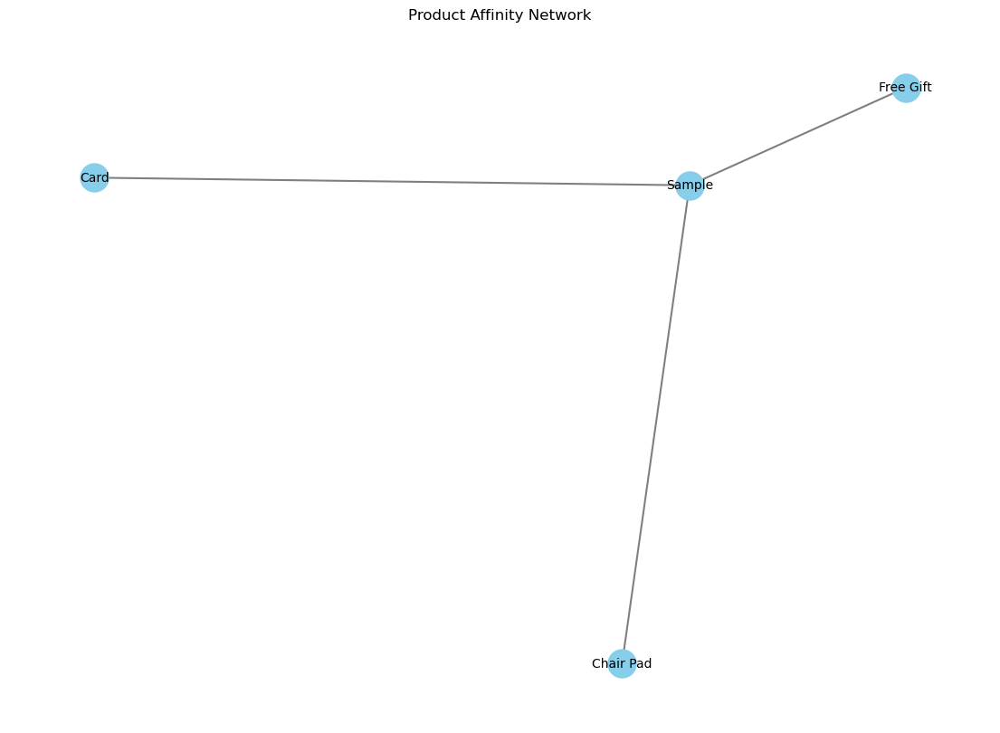

In [48]:
import matplotlib.pyplot as plt
import networkx as nx
G = nx.Graph()
for _, row in edge_df.iterrows():
    G.add_edge(row['source'], row['target'], weight=row['weight'])
plt.figure(figsize=(14, 10))
pos = nx.spring_layout(G, k=0.3) 
nx.draw_networkx_nodes(G, pos, node_size=500, node_color='skyblue')
nx.draw_networkx_edges(G, pos, alpha=0.5, width=1.5)
nx.draw_networkx_labels(G, pos, font_size=10)

plt.title('Product Affinity Network')
plt.axis('off')
plt.show()


# Topic Mining and Sentiment Analysis

In [12]:
import pandas as pd
import numpy as np

In [ ]:
# below codes are commented because its a pre processing of raw data and we have stored final data for use in submission. Use that directly

['', '', '', '', '', '', '', '']

In [16]:
# topic mining code starts
import pandas as pd
import numpy as np
from deep_translator import GoogleTranslator
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
from textblob import TextBlob
from wordcloud import WordCloud ,STOPWORDS
from nltk.corpus import stopwords
import re
import datetime
pd.set_option('display.max_colwidth', 1001)
pd.set_option('display.max_columns', 1001)
pd.set_option('display.width', 1001)
import warnings
warnings.filterwarnings('ignore')
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
from nltk.corpus import wordnet
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.model_selection import GridSearchCV
#pip install pyLDAvis
import pyLDAvis
import pyLDAvis.lda_model
import warnings
warnings.filterwarnings('ignore')

In [17]:
reviews_final=pd.read_csv('reviews_data_final.csv')

In [18]:
reviews_final

,review_title,product_id,rating,split_2_category,final_l0_category
0,Works perfect.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office
1,Ok good product.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office
2,Nice Product. Recommend it. But cleaning its exterior is cumbersome..,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office
3,Excellent product✌.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office
4,A good product for household use.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office
...,...,...,...,...,...
11498,Product review.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office
11499,Good quality.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office
11500,Good product.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office
11501,Good Product.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office


In [19]:
# now proceeding to build our custom text cleaning function : 
# This function was modified in multiple runs of LDA modeling, and plotting word clouds, frequency plots etc to arrive at a decent cleaning level
# we had to take care of words that are domain specific jargons and nouns. 
# Thus after multiple iterations of model, and to and fro, we arrived at following final text clean function


ps = PorterStemmer()
lemmatizer = WordNetLemmatizer()

stop_words=set(STOPWORDS)
stop_words=stop_words.union(set(stopwords.words('english')))
stop_words.add('im')
stop_words.add('u')
stop_words.add('got')

stop_words=stop_words.union(set(['get','it','and','to','for','is','the','of','at','there','are','in','you','will','was','have','has','hasnt','havent','wasnt','isnt','be','can','they','that'
           
                               ]))
# stop_words.remove('not')
# stop_words.remove('like')
# stop_words.remove('no')
# stop_words.remove('most')

def clean_text(text):
    text = text.str.lower()    # lowercase 
    text = text.str.strip()  # removing all spaces (useless)
     
    for a in text.index:
        print(round(a/pd.Series(text.index).iloc[-1],3), end='\r')
        #text[a]=GoogleTranslator(source='auto', target='en').translate(text[a])
        text[a] = re.sub(r"[-()\"#/@;:{}`+=~|_.!?,'0-9]", " ", text[a])        # getting rid of special characters and numbers
        text[a] = ' '.join( [w for w in text[a].split() if len(w)>1] )
        text[a] = re.sub(r' +', ' ', text[a])
        text[a] = re.sub(r'[^a-zA-Z_]', ' ', text[a])
        text[a]=re.sub('bakwaas','useless',text[a])
        text[a]=re.sub('not so good','bad',text[a])
        text[a]=re.sub('not good','bad',text[a])
        text[a]=re.sub('not at all good','bad',text[a])
    text = text.apply(lambda x: " ".join(lemmatizer.lemmatize(y) for y in x.split() ))
    text = text.apply(lambda x: " ".join(y for y in x.split() if y not in stop_words))  # removing stopwords
    text=text.apply(lambda x: " ".join(word_tokenize(x)))
    text = text.apply(lambda x: " ".join(y for y in x.split() if wordnet.synsets(y)))   # keeping words with some meaning, can be refined for respective business over time  
    return(text)

In [20]:
# cleaning our translated content
reviews_final['review_title_cleaned']=clean_text(reviews_final['review_title'].fillna(' ')) 

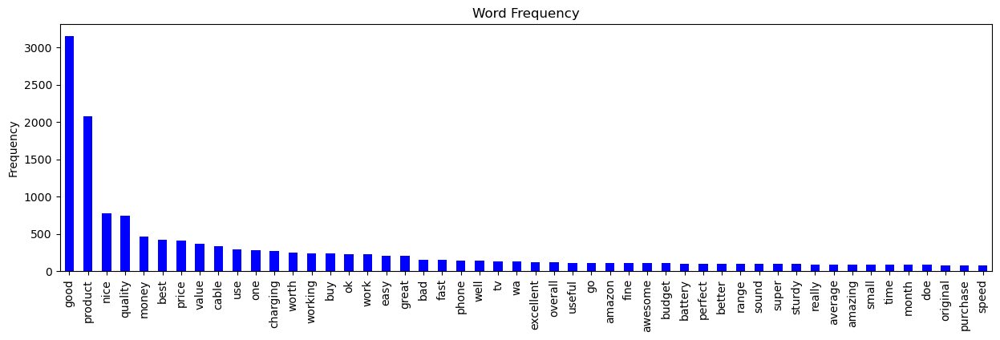

Sparsity:  99.74429496653046 %


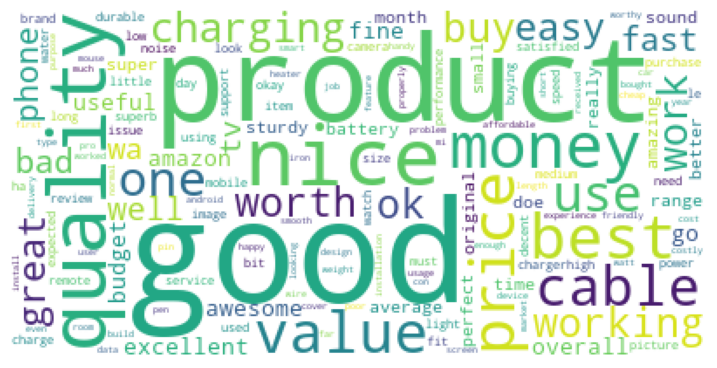

In [21]:

# Trying different vectorization methods ( Count and TFIDF) and frequency plot on entire text review data
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

# will be trying with mutiple n gram combination to arrive at final best params for max_features, ngram_range, min_df

countvect = CountVectorizer(analyzer='word', token_pattern=r'\w{1,}',ngram_range=(1,1 ), min_df=2, encoding='latin-1',max_features=800)
df1_count = countvect.fit_transform(reviews_final['review_title_cleaned'])
dtm_df1=df1_count.toarray()
dtm_df1=pd.DataFrame(dtm_df1, columns=countvect.get_feature_names_out())
word_freq = pd.DataFrame(dtm_df1.apply(sum), columns=['freq'])
word_freq.sort_values('freq', ascending=False, inplace=True)
word_freq.head(50).plot(kind='bar', color='blue', legend=False,figsize=(15,4)).set(title='Word Frequency', ylabel='Frequency')
plt.show()

# should be high, but not too high. 98-99% is good
print("Sparsity: ",(1-(np.count_nonzero(df1_count.toarray())/df1_count.toarray().size))*100,'%')

# plotting wordclouds, to see /analyze it a bit better and something that helps in adding an aesthetic appeal rather than just simple bar plots

wordcloud = WordCloud(background_color='white', stopwords=stop_words)
word_freq = dict(dtm_df1.apply(sum))
wordcloud = wordcloud.generate_from_frequencies(word_freq)   # from word frequency
fig = plt.figure(1, figsize=(9, 6))
plt.axis('off')
#import matplotlib as mpl
#mpl.rcParams['figure.dpi']= 200
plt.imshow(wordcloud)    # function to display data as image
plt.show() 

# clearly we can see most common words like book, issue, please, good,worst, ticket etc in our data are prevalent

In [12]:
word_freq=pd.Series(word_freq).reset_index()

In [14]:
word_freq.columns=['word','frequency']

In [15]:
word_freq.to_csv('word_frequency_for_wordcloud.csv',index=False)

In [16]:
reviews_final

,review_title,product_id,rating,split_2_category,final_l0_category,review_title_cleaned
0,Works perfect.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,work perfect
1,Ok good product.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,ok good product
2,Nice Product. Recommend it. But cleaning its exterior is cumbersome..,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,nice product recommend cleaning exterior cumbersome
3,Excellent product✌.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,excellent product
4,A good product for household use.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,good product household use
...,...,...,...,...,...,...
11498,Product review.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office,product review
11499,Good quality.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office,good quality
11500,Good product.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office,good product
11501,Good Product.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office,good product


,review_title,product_id,rating,split_2_category,final_l0_category,review_title_cleaned
0,Works perfect.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,work perfect
1,Ok good product.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,ok good product
2,Nice Product. Recommend it. But cleaning its exterior is cumbersome..,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,nice product recommend cleaning exterior cumbersome
3,Excellent product✌.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,excellent product
4,A good product for household use.,B01486F4G6,4.3,Kitchen&HomeAppliances,Home & Office,good product household use
...,...,...,...,...,...,...
11498,Product review.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office,product review
11499,Good quality.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office,good quality
11500,Good product.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office,good product
11501,Good Product.,B07JW9H4J1,4.2,Accessories&Peripherals,Home & Office,good product


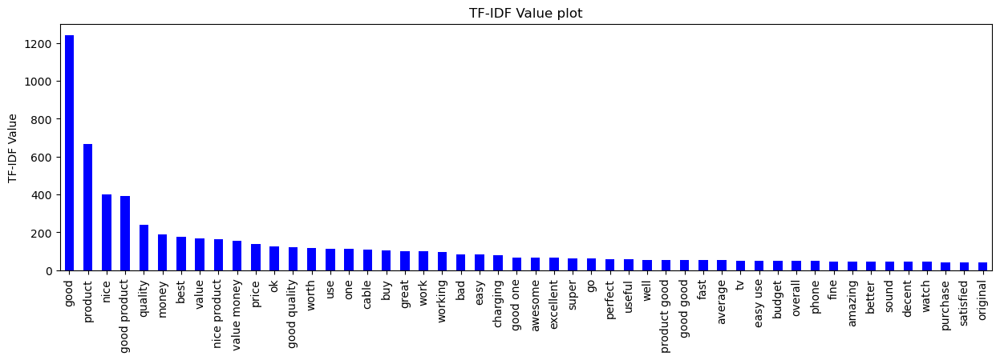

Sparsity:  99.6955142136834 %


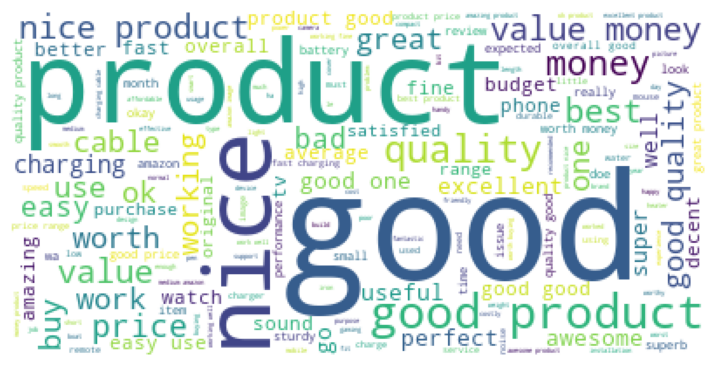

In [106]:
tfidf = TfidfVectorizer(analyzer='word', token_pattern=r'\w{1,}',ngram_range=(1,2 ), min_df=4, encoding='latin-1',max_features=800,smooth_idf=True)
df1_tfidf = tfidf.fit_transform(reviews_final['review_title_cleaned'])
dtm_df1_tf=df1_tfidf.toarray()
dtm_df1_tf=pd.DataFrame(dtm_df1_tf, columns=tfidf.get_feature_names_out())
word_freq = pd.DataFrame(dtm_df1_tf.apply(sum), columns=['tf_idf_value'])
word_freq.sort_values('tf_idf_value', ascending=False, inplace=True)
word_freq.head(50).plot(kind='bar', color='blue', legend=False,figsize=(15,4)).set(title='TF-IDF Value plot', ylabel='TF-IDF Value')
plt.show()
# should be high, but not too high. 98-99% is good
print("Sparsity: ",(1-(np.count_nonzero(df1_tfidf.toarray())/df1_tfidf.toarray().size))*100,'%')

wordcloud = WordCloud(background_color='white', stopwords=stop_words)
word_freq = dict(dtm_df1_tf.apply(sum))
wordcloud = wordcloud.generate_from_frequencies(word_freq)   # from word frequency
fig = plt.figure(1, figsize=(9, 6))
plt.axis('off')
#import matplotlib as mpl
#mpl.rcParams['figure.dpi']= 200
plt.imshow(wordcloud)    # function to display data as image
plt.show() 


In [113]:
# %%time # please do not run this cell, as it will take time. 
# making final models
#,max_features=800
countvect = CountVectorizer(analyzer='word', token_pattern=r'\w{1,}',ngram_range=(1,1 ), min_df=1, encoding='latin-1',max_features=800)
df1_count = countvect.fit_transform(reviews_final['review_title_cleaned'])
count_lda=LatentDirichletAllocation(random_state=0,learning_method='online',max_iter=10,learning_offset=4,n_components=10)
data_lda_count=count_lda.fit_transform(df1_count)

# for 20 topics -15k (good) to -40k (bad)
# Log Likelyhood: Higher the better
print("Log Likelihood: (Should be high) ", count_lda.score(df1_count))
# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
# 50-300 - good
# 300-1000 - medium
# >1000 - poor
print("Perplexity: (Should be low) ", count_lda.perplexity(df1_count))



#,max_features=800
tfidf = TfidfVectorizer(analyzer='word', token_pattern=r'\w{1,}',ngram_range=(1,1 ), min_df=1, encoding='latin-1',smooth_idf=True,max_features=800)
df1_tfidf = tfidf.fit_transform(reviews_final['review_title_cleaned'])

tf_lda=LatentDirichletAllocation(random_state=0,learning_method='online',max_iter=10,learning_offset=4,n_components=10)
data_lda_tf=tf_lda.fit_transform(df1_tfidf)

# for 20 topics -15k (good) to -40k (bad)
# Log Likelyhood: Higher the better
print("Log Likelihood: (Should be high) ", tf_lda.score(df1_tfidf))
# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
# 50-300 - good
# 300-1000 - medium
# >1000 - poor
print("Perplexity: (Should be low) ", tf_lda.perplexity(df1_tfidf))


Log Likelihood: (Should be high)  -142570.5263890105
Perplexity: (Should be low)  267.5928667378237
Log Likelihood: (Should be high)  -77526.16067873663
Perplexity: (Should be low)  591.2516770108864


In [114]:
pyLDAvis.enable_notebook()
panel = pyLDAvis.lda_model.prepare(count_lda, df1_count, countvect, mds='tsne')
pyLDAvis.save_html(panel, 'count_lda_approach.html')
panel

PreparedData(topic_coordinates=               x           y  topics  cluster       Freq
topic                                                   
6      74.387344  -75.827362       1        1  19.916106
2      86.062790   11.072206       2        1  11.050997
7      92.788773   98.623413       3        1  10.919532
3      10.305070  150.153412       4        1   9.634442
0     -93.770432   30.292604       5        1   9.121349
4     -17.333523 -108.972801       6        1   8.972172
5      -8.049686  -19.342978       7        1   8.168114
1     -81.322945  117.252884       8        1   7.761769
9       0.504134   60.632462       9        1   7.381508
8     -99.899323  -57.329872      10        1   7.074011, topic_info=        Term         Freq        Total Category  logprob  loglift
291     good  2635.000000  2635.000000  Default  30.0000  30.0000
545  product  1739.000000  1739.000000  Default  29.0000  29.0000
455     nice   717.000000   717.000000  Default  28.0000  28.0000
56      best   426.000000   426.000000  Default  27.0000  27.0000
438    money   442.000000   442.000000  Default  26.0000  26.0000
..       ...          ...          ...      ...      ...      ...
435    mixer    13.364020    14.249167  Topic10  -4.9054   2.5846
592   return    13.049483    13.934689  Topic10  -4.9292   2.5831
226   except    12.722714    13.607900  Topic10  -4.9546   2.5815
302     hand    12.519897    13.405174  Topic10  -4.9706   2.5804
199  display    25.577568    34.716848  Topic10  -4.2562   2.3432

[352 rows x 6 columns], token_table=      Topic      Freq         Term
term                              
5         8  0.871190         acer
15       10  0.981148   affordable
17        8  0.946415       almost
19        8  0.962576  alternative
21        1  0.981088      amazing
...     ...       ...          ...
792       9  0.996026        worth
793       2  0.978116       worthy
795       4  0.220940      writing
795       8  0.662821      writing
797       5  0.988214         year

[334 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 3, 8, 4, 1, 5, 6, 2, 10, 9])

In [115]:
pyLDAvis.enable_notebook()
panel = pyLDAvis.lda_model.prepare(tf_lda, df1_tfidf, tfidf, mds='tsne')
pyLDAvis.save_html(panel, 'tf_lda_approach_1.html')
panel

PreparedData(topic_coordinates=               x          y  topics  cluster       Freq
topic                                                  
6       2.964495   4.009060       1        1  15.922506
8     -21.126602  43.252388       2        1  10.628780
7      35.977661  -6.670931       3        1  10.599259
3     -30.291504   8.762302       4        1  10.296429
4     -61.732883  22.058184       5        1   9.509189
9     -17.789114 -22.439301       6        1   9.443061
0      18.061998  35.312157       7        1   9.371081
5      13.456304 -39.895626       8        1   9.062586
2     -56.449764 -20.419960       9        1   7.857292
1     -29.830179 -54.271046      10        1   7.309816, topic_info=        Term         Freq        Total Category  logprob  loglift
455     nice   433.000000   433.000000  Default  30.0000  30.0000
291     good  1125.000000  1125.000000  Default  29.0000  29.0000
56      best   242.000000   242.000000  Default  28.0000  28.0000
438    money   237.000000   237.000000  Default  27.0000  27.0000
756    value   208.000000   208.000000  Default  26.0000  26.0000
..       ...          ...          ...      ...      ...      ...
390     lint     5.714234     6.572284  Topic10  -5.0459   2.4761
279  getting     5.432018     6.290125  Topic10  -5.0966   2.4693
378       le    18.084913    22.912900  Topic10  -3.8938   2.3793
545  product    33.271821   711.024236  Topic10  -3.2842  -0.4460
790  working     9.757328    95.042367  Topic10  -4.5109   0.3396

[368 rows x 6 columns], token_table=      Topic      Freq         Term
term                              
2         7  0.898233   absolutely
5        10  0.936865         acer
15       10  0.961895   affordable
17        1  0.933491       almost
19       10  0.901074  alternative
...     ...       ...          ...
792       6  0.992263        worth
793       9  0.954437       worthy
795      10  0.855622      writing
797       5  0.836932         year
797       7  0.119562         year

[352 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 9, 8, 4, 5, 10, 1, 6, 3, 2])

In [116]:
# do not run this cell, as we have already trained this model and results are shared. This will take time to run with different initialization
import umap
from hdbscan import HDBSCAN
from bertopic import BERTopic
documents=reviews_final['review_title_cleaned'].to_list()
umap_model = umap.UMAP(n_neighbors=30, n_components=5, min_dist=0.0, metric='cosine')
hdbscan_model = HDBSCAN(min_cluster_size=15, min_samples=5, metric='euclidean',prediction_data = True)


bert_model=BERTopic(nr_topics=10,n_gram_range=(1,2),umap_model=umap_model,hdbscan_model=hdbscan_model)
bert_topics,proba=bert_model.fit_transform(documents)


README.md:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [117]:
bert_model.visualize_topics()

In [118]:
file=open("bert_model_intertopic_dist.html", "w")
file.write(bert_model.visualize_topics().to_html())

4665406

In [120]:
bert_model.topic_labels_

{-1: '-1_good_product_price_quality',
 0: '0_good_good good_nice_ok',
 1: '1_product_good_good product_quality',
 2: '2_cable_charging_fast_fast charging',
 3: '3_tv_watch_remote_smart',
 4: '4_mouse_button_touch_keyboard',
 5: '5_battery_backup_life_battery backup',
 6: '6_average_average average_average quality_average product',
 7: '7_light_brightness_dark_place sunlight',
 8: '8_boat_boat boat_better boat_boat better'}

In [125]:

bert_model.visualize_hierarchy(top_n_topics=40)

## senstivity analysis

In [126]:
# with embeddings
from transformers import pipeline
sentiment_analyzer = pipeline("sentiment-analysis")

No model was supplied, defaulted to distilbert/distilbert-base-uncased-finetuned-sst-2-english and revision 714eb0f (https://huggingface.co/distilbert/distilbert-base-uncased-finetuned-sst-2-english).
Using a pipeline without specifying a model name and revision in production is not recommended.
Device set to use mps:0


In [127]:
sent=[]
sent_score=[]
for i,x in enumerate(reviews_final['review_title_cleaned']):
    print(i,end='\r')
    sent_val=sentiment_analyzer(x)
    sent_val_val=sent_val[0]['label']
    score=sent_val[0]['score']
    sent.append(sent_val_val)
    sent_score.append(score)
    #break
reviews_final['sentiment']=pd.Series(sent)
reviews_final['sentiment_score']=pd.Series(sent_score)


In [ ]:
mapping_topics=bert_model.topic_labels_

In [130]:
len(reviews_final)

11503

In [131]:
reviews_final['bert_topics']=bert_topics

In [135]:
reviews_final['name_of_topic']=reviews_final['bert_topics'].apply(lambda x: mapping_topics[x])

In [139]:
reviews_final.sentiment.value_counts()

sentiment
POSITIVE    10320
NEGATIVE     1183
Name: count, dtype: int64

In [137]:
reviews_final.to_parquet('reviews_final_with_sentiment_and_topics.parquet')

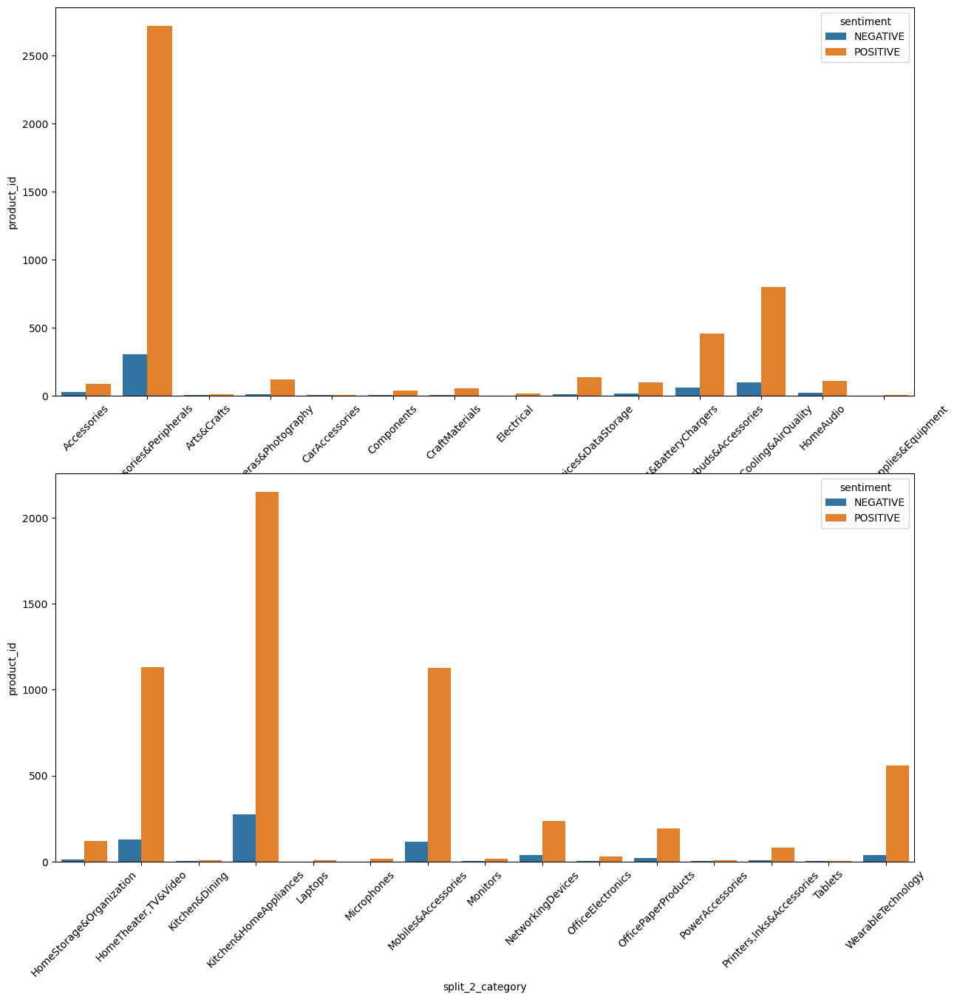

In [174]:
# multiply each entry by 100
PLOT=reviews_final.groupby(['split_2_category','sentiment'])['product_id'].count()
PLOT=PLOT.reset_index()
import seaborn as sns
fig, ax=plt.subplots(2,1,figsize=(15,15))
sns.barplot(PLOT.iloc[0:26],x='split_2_category',y='product_id',hue='sentiment',ax=ax[0])
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=45)
sns.barplot(PLOT[26:],x='split_2_category',y='product_id',hue='sentiment',ax=ax[1])
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=45)
plt.show()


In [1]:
import pandas as pd

In [11]:
reviews.groupby('split_2_category')['name_of_topic'].unique()

split_2_category
Accessories                                [Good Review, Product Quality Related, General...
Accessories&Peripherals                    [Good Review, Product Quality Related, Average...
Arts&Crafts                                [Product Quality Related, General Review, Good...
Cameras&Photography                        [Good Review, Product Quality Related, Electro...
CarAccessories                             [Good Review, Product Quality Related, General...
Components                                 [Good Review, Product Quality Related, Compute...
CraftMaterials                             [Product Quality Related, Good Review, General...
Electrical                                                     [Good Review, General Review]
ExternalDevices&DataStorage                [General Review, Good Review, Product Quality ...
GeneralPurposeBatteries&BatteryChargers    [Good Review, Electronics-Charging Related, Ge...
Headphones,Earbuds&Accessories             [General R